# **Analiza mreže javnog gradskog prevoza grada Beograda**
### Marko Mićović, Luka Miletić ###
Gradski saobraćaj predstavlja veoma važnu komponentu jednog velikog grada, te je od
izuzetnog značaja njegova analiza i optimizacija. Na transportnu mrežu jednog grada uobičajeno
utiče veći broj faktora, kao što su geografija, istorijsko nasleđe, ekonomski, kulturni i socijalni
razlozi. Stoga se velika pažnja posvećuje planiranju saobraćajne mreže, kako bi njeno širenje na
kvalitetan način odgovorilo potrebama stanovnika

In [ ]:
%pip install powerlaw
%pip install 'scipy>=1.8'

import math
import pickle
import powerlaw
import itertools

import numpy as np
import pandas as pd
import datetime as dt
import networkx as nx
import matplotlib.pyplot as plt

from google.colab import drive
from collections import Counter
from networkx.algorithms import bipartite
from sklearn import metrics
from sklearn.cluster import SpectralClustering

np.random.seed(1)

drive.mount('/content/drive')
master_path = "/content/drive/MyDrive/Colab Notebooks/GSP/"

# Pregled i čišćenje podataka

In [ ]:
def checkValues(data, col, expectIsUnique=False):
  hasNull = data[col].isnull().values.any()
  isUnique = data[col].is_unique

  if hasNull:
    print(col + " has null values!")

  if expectIsUnique and not isUnique:  
    print(col + " is not unique!")

## Routes tabela

In [ ]:
routesDataPath = master_path + "data/routes.txt"
routesData = pd.read_csv(routesDataPath)
display(routesData)

In [ ]:
checkValues(routesData, 'route_id', expectIsUnique=True)
checkValues(routesData, 'route_short_name', expectIsUnique=True)
checkValues(routesData, 'route_long_name', expectIsUnique=True)
checkValues(routesData, 'route_type')
checkValues(routesData, 'route_color')
checkValues(routesData, 'route_text_color')

0 - Tramvaji, 3 - Autobusi, 702 - E linije, 800 - Trole

Long name nije unique.

In [ ]:
routesData.drop(['agency_id', 'route_desc', 'route_url', 'route_color', 'route_text_color'], axis=1, inplace=True)

In [ ]:
with open(master_path + "data_cleaned/routes.txt", 'wb') as file:
    pickle.dump(routesData, file)

## Trips tabela

In [ ]:
tripsDataPath = master_path + "data/trips.txt"
tripsData = pd.read_csv(tripsDataPath)
display(tripsData)

In [ ]:
checkValues(tripsData, 'route_id')
checkValues(tripsData, 'service_id')
checkValues(tripsData, 'trip_id', expectIsUnique=True)
checkValues(tripsData, 'direction_id')

In [ ]:
display(tripsData['service_id'].unique())

Uključen je samo zimski raspored vožnje.

In [ ]:
tripsData.drop(['trip_headsign', 'block_id', 'shape_id', 'wheelchair_accessible', 'bikes_allowed'], axis=1, inplace=True)

In [ ]:
with open(master_path + "data_cleaned/trips.txt", 'wb') as file:
    pickle.dump(tripsData, file)

## Stop times tabela

In [ ]:
stopTimesDataPath = master_path + "data/stop_times.txt"
stopTimesData = pd.read_csv(stopTimesDataPath, dtype={'stop_headsign': 'str'})
display(stopTimesData)

In [ ]:
checkValues(stopTimesData, 'trip_id')
checkValues(stopTimesData, 'arrival_time')
checkValues(stopTimesData, 'departure_time')
checkValues(stopTimesData, 'stop_id')
checkValues(stopTimesData, 'stop_sequence')

1. Da li postoji timepoint da nije 0? \\
   Ne.
2. Da li su pickup_type i drop_off_type uvek null? \\
  Jesu
3. Zasto se pojavljuje null za arrival time i departure time na nekim mestima? \\
Linija 703L1 za svoju drugu stanicu uvek ime null za ta polja, ali nam to nije značajno za ovo istraživanje.
4. Da li su arrival time i departure time uvek isti? \\
 Jesu, smatra se da po pristizanju prevoza on krece istog trenutka.



In [ ]:
display(stopTimesData[stopTimesData['timepoint'] != 0])

In [ ]:
display(stopTimesData[stopTimesData['pickup_type'].notnull()])
display(stopTimesData[stopTimesData['drop_off_type'].notnull()])

In [ ]:
display(stopTimesData[(stopTimesData['departure_time'].isnull()) | stopTimesData['arrival_time'].isnull()])

In [ ]:
display(stopTimesData[(stopTimesData['arrival_time'] != stopTimesData['departure_time'])])

In [ ]:
stopTimesData.drop(['departure_time', 'stop_headsign', 'pickup_type', 'drop_off_type', 'shape_dist_traveled', 'timepoint'], axis=1, inplace=True)

In [ ]:
with open(master_path + "data_cleaned/stop_times.txt", 'wb') as file:
    pickle.dump(stopTimesData, file)

## Stops tabela

In [ ]:
stopsDataPath = master_path + "data/stops.txt"
stopsData = pd.read_csv(stopsDataPath)
display(stopsData)

In [ ]:
checkValues(stopsData, 'stop_id')
checkValues(stopsData, 'stop_code')
checkValues(stopsData, 'stop_name')
checkValues(stopsData, 'stop_lat')
checkValues(stopsData, 'stop_lon')
checkValues(stopsData, 'zone_id')

1. Da li postoji location_type a da nije 0? Ne.
2. Da li postoji parent_station a da nije NaN? Ne.
3. Da li postoji stop_timezone a da nije NaN? Ne.
4. Koje zone postoje? Postoje samo stanice iz prve tri zone. \\
  Takođe ne postoje linije koje prolaze kroz zonu 4, niti stanice iz prve tri zone na koje staju samo te neuključene linije.
5. Da li je stop_id uvek isti kao stop_code? Jeste.

In [ ]:
display(stopsData[stopsData['location_type'] != 0])

In [ ]:
display(stopsData['parent_station'].notnull().values.any())
display(stopsData['stop_timezone'].notnull().values.any())

In [ ]:
display(stopsData['zone_id'].unique())

In [ ]:
display(stopsData[stopsData['stop_id'] != stopsData['stop_code']])

In [ ]:
stopsData.drop(['stop_code', 'stop_desc', 'stop_url', 'location_type', 'parent_station', 'stop_timezone', 'wheelchair_boarding'], axis=1, inplace=True)

In [ ]:
with open(master_path + "data_cleaned/stops.txt", 'wb') as file:
    pickle.dump(stopsData, file)

## Calendar tabele

In [ ]:
calendarDataPath = master_path + "data/calendar.txt"
calendarData = pd.read_csv(calendarDataPath)
display(calendarData)

Zimski period greškom obuhvata i letnji period, trebao bi da ide do 2023 06 30.

In [ ]:
calendarDatesDataPath = master_path + "data/calendar_dates.txt"
calendarDatesData = pd.read_csv(calendarDatesDataPath)
display(calendarDatesData)

Datumi u ovoj tabeli se odnose na 2019/2020 period, dok se u calendar tabeli odnose na 2022/2023. Treba allign-ovati.

S obzirom da nemamo letnji raspored vožnje, ovo dve tabele nam nisu značajne.

## Ostale tabele

Ostale tabele su: Agency, fare_attributes, fare_rules, fare_info, frequencies, shapes, i transfers. One su ili prazne ili nam nisu od interesa.

# Učitavanje očišćenih tabela

In [ ]:
with open(master_path + "data_cleaned/routes.txt", 'rb') as file:
    routes = pickle.load(file)

display(routes)

In [ ]:
with open(master_path + "data_cleaned/trips.txt", 'rb') as file:
    trips = pickle.load(file)

display(trips)

In [ ]:
with open(master_path + "data_cleaned/stop_times.txt", 'rb') as file:
    stopTimes = pickle.load(file)

display(stopTimes)

In [ ]:
with open(master_path + "data_cleaned/stops.txt", 'rb') as file:
    stops = pickle.load(file)

display(stops)

In [ ]:
stopsRoutes = stopTimes[['stop_id', 'trip_id']].merge(trips[['trip_id', 'route_id']], on='trip_id')

stopsRoutes.drop(['trip_id'], axis=1, inplace=True)
stopsRoutes.drop_duplicates(inplace=True)

stopsRoutes = stopsRoutes.merge(stops[['stop_id', 'stop_name']], on='stop_id')

display(stopsRoutes)

# **Statistička obrada podataka**

## Frekvencija
Odrediti prosečno vreme između dva polaska svake od linija. Koje su linije sa najčešćim, a koje sa najređim polascima?

Pravimo tabelu polazaka u kojoj je za svaki polazak dodeljeno vreme kretanja

In [ ]:
filteredStopTimes = stopTimes[stopTimes['stop_sequence'] == 1][['trip_id', 'arrival_time']].rename(columns={'arrival_time':'start_time'})
tripsWithStartTime = trips.merge(filteredStopTimes, on='trip_id')
display(tripsWithStartTime)

In [ ]:
def toTime(timeString):
  hours, rest = timeString.split(':', 1)
  hours = int(hours)
  day = 0
  if hours > 23:
    hours -= 24
    day = 1
  return dt.timedelta(hours=hours, days=day) + dt.datetime.strptime(rest, '%M:%S')

Prosek možemo računati posebno za svaki smer i svaku vrstu rasporeda (Radni dani, subota, nedelja). \\
Posebno ćemo istraživati po vrsti rasporeda, a za smerove ćemo uzimati prosek.

In [ ]:
def countTripFrequencyPerDirection(routeRow, serviceId, direction):
  route = routeRow['route_id']
  tripsForRoute = tripsWithStartTime[(tripsWithStartTime['route_id'] == route) & (tripsWithStartTime['service_id'] == serviceId) & (tripsWithStartTime['direction_id'] == direction)]

  # drop routes with only one trip for the day, their frequency can't be measured
  if tripsForRoute.shape[0] < 2:
    return None

  firstStart = toTime(tripsForRoute['start_time'].min())
  lastStart = toTime(tripsForRoute['start_time'].max())

  difference = lastStart - firstStart
  frequency = difference / (tripsForRoute.shape[0] - 1)

  return frequency

def countTripFrequency(routeRow, serviceId):
  freq0 = countTripFrequencyPerDirection(routeRow, serviceId, 0)
  freq1 = countTripFrequencyPerDirection(routeRow, serviceId, 1)
  
  if pd.isnull(freq0):
    return freq1

  if pd.isnull(freq1):
    return freq0

  # If there are more than 1 trips in both directions, return the average period
  return (freq0 + freq1) / 2

In [ ]:
def displayAverageStartPeriod(serviceId):
  routesTemp = routes[['route_id', 'route_short_name']].copy()

  routesTemp['Frequency'] = routesTemp.apply(lambda row: countTripFrequency(row, serviceId), axis = 1)

  # Drop routes for which frequency couldn't be measured
  routesTemp.drop(routesTemp[pd.isnull(routesTemp['Frequency'])].index, inplace=True)

  print('Najšešće rute', end="\n\n")
  display(routesTemp.sort_values(by='Frequency').head())
  print('\n')

  print('Najmanje česte rute', end="\n\n")
  display(routesTemp.sort_values(by='Frequency', ascending=False).head())
  print('\n')

In [ ]:
print('Radni dani:', end="\n\n\n")
displayAverageStartPeriod('Zimski-Radni Dan')

print('Subota:', end="\n\n\n")
displayAverageStartPeriod('Zimski-Subota')

print('Nedelja:', end="\n\n\n")
displayAverageStartPeriod('Zimski-Nedelja')

## Stepen linija i stanica
Koje su linije sa najvećim brojem stanica, a koje stanice sa najvećim brojem linija?

In [ ]:
stopsWithRouteCount = stopsRoutes.groupby(['stop_id', 'stop_name'], as_index=False).count().rename(columns={'route_id':'routes'})
display(stopsWithRouteCount.sort_values(by='routes', ascending=False).head())

In [ ]:
routesWithStopCount = stopsRoutes.groupby(['route_id'], as_index=False)['stop_id'].count().rename(columns={'stop_id':'stops'})
routesWithStopCount = routesWithStopCount.merge(routes[['route_id', 'route_short_name']], on='route_id')[['route_short_name', 'stops']]
display(routesWithStopCount.sort_values(by='stops', ascending=False).head(10))

Linije ima začuđujuć broj stanica iz dva razloga:
1. Računaju se sve stanice u oba smera
2. Neke linije (npr. 601N) idu različitim putevima u različitim polascima

## Dnevni promet stanica

Preračunati očekivani dnevni promet stanice kao ukupan očekivani broj stajanja linije na toj stanici, određen na osnovu planiranog rasporeda vožnje. Koje su stanice sa najvećim očekivanim dnevnim prometom?

In [ ]:
stopTimesWithServiceId = stopTimes[['trip_id', 'stop_id']].merge(trips[['trip_id', 'service_id']], on='trip_id').merge(stops[['stop_id', 'stop_name']], on='stop_id')
stopTimesWithServiceId.drop(['trip_id'], axis=1, inplace=True)

def countFlowPerStop(serviceId):
  stopTimesFiltered = stopTimesWithServiceId[stopTimesWithServiceId['service_id'] == serviceId]
  stopsWithFlow = stopTimesFiltered.groupby(['stop_id', 'stop_name'], as_index=False).count().rename(columns={'service_id': 'count'})
  display(stopsWithFlow.sort_values(by='count', ascending=False))

print('Radni dan', end="\n\n")
countFlowPerStop('Zimski-Radni Dan')
print('\n')

print('Subota', end="\n\n")
countFlowPerStop('Zimski-Subota')
print('\n')

print('Nedelja', end="\n\n")
countFlowPerStop('Zimski-Nedelja')

## Stanice po tipu

Svakoj stanici dodeliti tip na osnovu vrsta prevoza koje prolaze njom (stanica autobusa, *tramvaja*, trolejbusa ili meštovita stanica). Koliko ima stanica svakog tipa?

In [ ]:
stopsRoutesWithRouteType = stopsRoutes.merge(routes[['route_id', 'route_type']], on='route_id')
stopsRoutesWithRouteType.drop(['route_id'], axis=1, inplace=True)

# Tramvaji = 1, Autobusi = 10 i E-prevozi = 10, Trole = 100
stopsRoutesWithRouteType['route_type'] = stopsRoutesWithRouteType['route_type'].map({0: 1, 3: 10, 702: 10, 800: 100})
stopsRoutesWithRouteType.drop_duplicates(inplace=True)

Od mešanih stanica postoje samo 110 (Trole i Autobusi) i 11 (Tramvaji i Autobusi), jer Trole i Tramvaji nikada ne idu zajedno

In [ ]:
# 101 and 111 do not exist
stopsWithStopType = stopsRoutesWithRouteType.groupby(['stop_id'], as_index=False)['route_type'].sum().rename(columns={'route_type':'stop_type'})
stopsWithStopType['stop_type'] = stopsWithStopType['stop_type'].map({1: 'Tramvajska', 10: 'Autobuska', 100: 'Trolebuska', 11: 'Mešovita', 110: 'Mešovita'})
display(stopsWithStopType)

In [ ]:
stopTypesWithCount = stopsWithStopType.groupby(['stop_type'], as_index=False).count().rename(columns={'stop_id':'count'})
display(stopTypesWithCount)

# Konstrukcija grafova

## BGNetL

In [ ]:
# Create a directed graph of stops with stop_name and zone_id as node attributes
netL = nx.DiGraph()

stopList = stops['stop_id'].values.tolist()
netL.add_nodes_from(stopList)

nodeDF = stops[['stop_id', 'stop_name', 'zone_id', 'stop_lat', 'stop_lon']].rename(columns={"stop_lat": "y", "stop_lon": "x"})
nodeDF['x'] = nodeDF['x']
nodeDF['y'] = nodeDF['y']

node_attr = nodeDF.set_index('stop_id').to_dict('index')
nx.set_node_attributes(netL, node_attr)

In [ ]:
# Create a dataframe of day routes and one of their trips in each direction
dayRoutes = routes[~(routes['route_short_name'].str.contains('N'))]
workDayTrips = trips[trips['service_id'] == 'Zimski-Radni Dan']
workDayTrips = workDayTrips.merge(dayRoutes, on='route_id')[['route_id', 'trip_id', 'direction_id']]
workDayTrips.drop_duplicates(subset=['route_id', 'direction_id'], keep='first', inplace=True)

In [ ]:
workDayTripSequences = workDayTrips.merge(stopTimes, on='trip_id').sort_values(by=['route_id', 'direction_id', 'stop_sequence'])
display(workDayTripSequences)

Grane dodajemo parsiranjem stopsTimes tabele, trip po trip, stanica po stanica

In [ ]:
def connect(route, firstStop, secondStop):
  if firstStop == secondStop:
    return
  
  if (firstStop, secondStop) in netL.edges:
    netL.edges[firstStop, secondStop]['weight'] += 1
  else:
    netL.add_edge(firstStop, secondStop, weight=1)

In [ ]:
previousStop = None
previousRoute = None
firstRouteStop = None
bothDirectionsExist = False

for _, route_id, _, direction_id, _, stop_id, stop_sequence in workDayTripSequences.itertuples():
  # If we are on the next station, same direction
  if stop_sequence > 1:
    connect(route_id, previousStop, stop_id)
    previousStop = stop_id
    continue
    
  # If direction changed on the same route
  if previousRoute == route_id:
    bothDirectionsExist = True
    connect(route_id, previousStop, stop_id) # Connect last of dir 0 with first of dir 1
    previousStop = stop_id
    continue

  # We are on a new route
  if previousRoute != None and bothDirectionsExist:      # If there is a previous route with two directions
    connect(previousRoute, previousStop, firstRouteStop) # Connect last of dir 1 with first of dir 1

  bothDirectionExist = False
  firstRouteStop = stop_id
  previousRoute = route_id
  previousStop = stop_id

# And of loop, connect last of dir 1 with first of dir 1 for the last route
if previousRoute != None and bothDirectionsExist:
  connect(previousRoute, previousStop, firstRouteStop)


Brišemo sve stanica kroz koje su išle samo noćne linije (3757, 3737, 3735, 1247, 1245, 1243) kako bismo dobili povezanu komponentu za lakšu analizu

In [ ]:
# Deletes all stops with no edges
netL.remove_nodes_from(list(nx.isolates(netL)))

In [ ]:
output_path = master_path + "models/netL.gml"
nx.write_gml(netL, output_path)

## BGNetB

In [ ]:
# Create a bipartitive graph of stops and routes
netB = nx.Graph()

stopList = stops['stop_id'].values.tolist()
netB.add_nodes_from(stopList, bipartite=0)

# Routes and stops share some ids
# We are ofsetting route ids by 10000 to differentiate them from stops
routeOffset = 10000

dayRouteDF = routes[~(routes['route_short_name'].str.contains('N'))].copy()
dayRouteDF['route_id'] = dayRouteDF['route_id'] + routeOffset
dayRouteList = dayRouteDF['route_id'].tolist()
netB.add_nodes_from(dayRouteList, bipartite=1)

stopNodeDF = stops[['stop_id', 'stop_name', 'zone_id', 'stop_lat', 'stop_lon']].rename(columns={"stop_lat": "y", "stop_lon": "x"})
stopNodeDF['x'] = stopNodeDF['x']
stopNodeDF['y'] = stopNodeDF['y']

routeNodeDF = routes[['route_id', 'route_short_name', 'route_long_name', 'route_type']]
routeNodeDF['route_id'] = routeNodeDF['route_id'] + routeOffset

stop_node_attr = stopNodeDF.set_index('stop_id').to_dict('index')
nx.set_node_attributes(netB, stop_node_attr)

route_node_attr = routeNodeDF.set_index('route_id').to_dict('index')
nx.set_node_attributes(netB, route_node_attr)

In [ ]:
# Create a dataframe that connects all day routes with their stops
# All routes with ids [50000, 60000) are night routes
dayStopsRoutes = stopsRoutes[(stopsRoutes['route_id'] < 50000) | (stopsRoutes['route_id'] >= 60000)]

In [ ]:
# Add an edge for every combination of stop and day route
for _, stop_id, route_id, _ in dayStopsRoutes.itertuples():
  netB.add_edge(stop_id, route_id + routeOffset, weight=1)

Brišemo sve stanica kroz koje su išle samo noćne linije (3757, 3737, 3735, 1247, 1245, 1243) kako bismo dobili povezanu komponentu za lakšu analizu

In [ ]:
# Deletes all stops with no edges
netB.remove_nodes_from(list(nx.isolates(netB)))

## BGNetP

Graf P je projekcija grafa B na čvorove stanice

In [ ]:
stop_nodes = {n for n, d in netB.nodes(data=True) if d['bipartite'] == 0}
netP = bipartite.weighted_projected_graph(netB, stop_nodes)

In [ ]:
output_path = master_path + "models/netP.gml"
nx.write_gml(netP, output_path)

## BGNetC

Graf C je projekcija grafa B na čvorove linije

In [ ]:
route_nodes = {n for n, d in netB.nodes(data=True) if d['bipartite'] == 1}
netC = bipartite.weighted_projected_graph(netB, route_nodes)

In [ ]:
output_path = master_path + "models/netC.gml"
nx.write_gml(netC, output_path)

## BGNetLWalk

Kako bismo težili da ne spajamo dve stanice među kojima direktno ide autobus, ispitujemo razdaljine između svako dvoje sukcesivnih stanica.

In [ ]:
# Create a dataframe of day routes and one of their trips in each direction
dayRoutes = routes[~(routes['route_short_name'].str.contains('N'))]
workDayTrips = trips[trips['service_id'] == 'Zimski-Radni Dan']
workDayTrips = workDayTrips.merge(dayRoutes, on='route_id')[['route_id', 'trip_id', 'direction_id']]
workDayTrips.drop_duplicates(subset=['route_id', 'direction_id'], keep='first', inplace=True)

In [ ]:
workDayTripSequences = workDayTrips.merge(stopTimes, on='trip_id')
workDayTripSequences = workDayTripSequences.merge(stops, on='stop_id')[['route_id', 'direction_id', 'stop_id', 'stop_sequence', 'stop_lat', 'stop_lon']]
workDayTripSequences = workDayTripSequences.sort_values(by=['route_id', 'direction_id', 'stop_sequence'])
display(workDayTripSequences)

In [ ]:
R = 6371 * 1000

def measure_distance(lat1, lon1, lat2, lon2):
  t1 = math.pow(math.sin(math.radians(lat1 - lat2) / 2), 2)
  t2 = math.pow(math.sin(math.radians(lon1 - lon2) / 2), 2)
  d = 2 * R * math.asin(math.sqrt(t1 + t2 * math.cos(math.radians(lat1)) * math.cos(math.radians(lat2))))
  return d

In [ ]:
previousStop = None
previousLat = None
previousLon = None

stopDistances = pd.DataFrame(columns = ['stop1', 'stop2', 'distance'])

for _, route_id, direction_id, stop_id, stop_sequence, stop_lat, stop_lon in workDayTripSequences.itertuples():
  # If we are on the next station, same direction
  if stop_sequence > 1:
    distance = measure_distance(previousLat, previousLon, stop_lat, stop_lon)
    df2 = {'stop1': previousStop, 'stop2': stop_id, 'distance': distance}
    stopDistances = stopDistances.append(df2, ignore_index = True)

  previousStop = stop_id
  previousLon = stop_lon
  previousLat = stop_lat

stopDistances.drop_duplicates(inplace=True)

In [ ]:
display(stopDistances.sort_values(by='distance').head(15))

Nule se odnose na rutu 38L za koju postoji greška u podacima (duple stanice).

Analiziranjem ostalih niskih vrednosti primetili smo da postoji dosta primera ruta koje prave male krugove, ili nagla skretanja. Radi boljih rezultata takve stvari smo ignorisali i opredelili se za distancu spajanja od 100 metara.

U slučaju da stanice imaju isto ime izabrana je vrednost od 170 metara. Kao referenca za tu vrednost uzeto je jezgro stajališta 'Zeleni Venac'.

I stanice sa istim imenom moraju imati neku maksimalnu vrednost, jer postoje slučajevi drastično udaljenih stanica kao što su stanice 'Kneza Višeslava'.


In [ ]:
WalkDistance = 100
SameNameStationDistance = 170

In [ ]:
netLWalk = netL.copy()

In [ ]:
def connectStopsByWalk(firstStop, secondStop):
  if firstStop == secondStop:
    return
    
  if (firstStop, secondStop) not in netLWalk.edges:
    netLWalk.add_edge(firstStop, secondStop, weight=1)

  if (secondStop, firstStop) not in netLWalk.edges:
    netLWalk.add_edge(secondStop, firstStop, weight=1)

In [ ]:
def shouldConnectStopsByWalk(firstStop, secondStop):
  distance = measure_distance(firstStop['y'], firstStop['x'], secondStop['y'], secondStop['x'])

  if distance <= WalkDistance:
    return True

  return firstStop['stop_name'] == secondStop['stop_name'] and distance <= SameNameStationDistance

In [ ]:
display(netL.number_of_nodes())
display(netL.number_of_edges())

In [ ]:
for stop1, stop2 in itertools.combinations(netLWalk.nodes, 2):
  if shouldConnectStopsByWalk(netLWalk.nodes[stop1], netLWalk.nodes[stop2]):
      connectStopsByWalk(stop1, stop2)

In [ ]:
display(netLWalk.number_of_nodes())
display(netLWalk.number_of_edges())

In [ ]:
display(netLWalk.number_of_edges()-netL.number_of_edges())

Dodato je **3867** grana za šetanje između stanica.

In [ ]:
output_path = master_path + "models/netLWalk.gml"
nx.write_gml(netLWalk, output_path)

# **BGNetL Analiza**

## Osnovna karakterizacija

### 5) Gustina mreže

In [ ]:
netLDensity = nx.density(netL)
print(f'Density: {netLDensity}')

Mreža je veoma retka

### 6) Prosečne distance i dijametar mreže

In [ ]:
netLAverageDistance = nx.average_shortest_path_length(netL)
netLDiameter = nx.diameter(netL)

print(f'Average distance: {netLAverageDistance}')
print(f'Diameter: {netLDiameter}')

### 7) Broj i veličine povezanih komponenti

In [ ]:
print(f'Is strongly connected: {nx.is_strongly_connected(netL)}')
print(f'Number of strongly connected components: {nx.number_strongly_connected_components(netL)}')

Mreža je jako povezana tako da je broj komponenti 1. \\
Pre izbacivanja nepovezanih stanica broj komponenata je bio 7, gde je jedna bila gigantska komponenta.

### 8) a) Koliki je prosečni, a koliki globalni koeficijent klasterizacije mreže?

In [ ]:
netLAverageClustering = nx.average_clustering(netL, weight='weight')
netLGlobalClustering = nx.transitivity(netL)

print(f'Average clustering: {netLAverageClustering}')
print(f'Global clustering: {netLGlobalClustering}')

### 8) b) Kakva je raspodela lokalnog koeficijenta klasterizacije njenih čvorova?

Velika većina čvorova ima koeficijent klasterizacije 0.

In [ ]:
def plot_clustering(G, weighted = False, logScale = False):
  if weighted:
      clustering = nx.clustering(G, weight="weight")
  else:
      clustering = nx.clustering(G)
      
  for key, value in clustering.items():
    clustering[key] = math.floor(value * 40) / 40

  clust_counts = Counter(clustering.values())
  print(clust_counts)
  x, y = zip(*clust_counts.items())

  plt.ylabel('frequency')
  if weighted:
    plt.xlabel('weighted clustering')
  else:
    plt.xlabel('clustering')                                             

  plt.bar(clust_counts.keys(), clust_counts.values(), 0.025, align='edge', color='darkred', log=logScale, edgecolor="black")

In [ ]:
plot_clustering(netL, weighted = True, logScale = True)

### 8) c) Da li je klasterisanje izraženo ili ne? (U poređenju sa Erdos-Renyi modelom)


Maksimalan broj grana je $M =  \frac{n*(n-1)}{2} $  
Mi imamo $m$ grana  
$ p * M = m \Rightarrow p = \frac{m}{M} = \frac{2m}{n*(n-1)}$  

In [ ]:
n = netL.number_of_nodes()
m = netL.number_of_edges()
p = ( 2*float(m) ) / ( n* (n-1) )

netLER = nx.erdos_renyi_graph(n,p)
netLSFMulti = nx.scale_free_graph(n)

netLSF = nx.DiGraph()
for u,v in netLSFMulti.edges():
    if netLSF.has_edge(u,v):
        netLSF[u][v]['weight'] += 1
    else:
        netLSF.add_edge(u, v, weight=1)

In [ ]:
netLERAverageClustering = nx.average_clustering(netLER)
netLSFAverageClustering = nx.average_clustering(netLSF)

print(f'ER Average clustering: {netLERAverageClustering}')
print(f'SF Average clustering: {netLSFAverageClustering}')

Prosečni koeeficijent klasterizacije je istog reda veličine kao i erdoš-renijev model, što sugeriše da je mreža slabo klasterisana.

### 9) Da li iskazuje osobine malog sveta:
S obzirom na velike razdaljine i mali globalni koeficijent klasterizacije, mreža ne pokazuje osobine malog sveta.

### 10) Asortativna analiza po stepenu čvora. Da li je izraženo asortativno mešanje?


Asortativnost (eng. assortativity) meri stepen tendencije čvorova mreže da se vezuju sa sličnim čvorovima.

In [ ]:
netLUWAssortativity = nx.degree_assortativity_coefficient(netL)
print(f"Netežinski koeficijent asortativnosti: {netLUWAssortativity}")

netLWAssortativity = nx.degree_assortativity_coefficient(netL, weight='weight')
print(f"Težinski koeficijent asortativnosti: {netLWAssortativity}")

Netežinski gledano, mreža je slabo asortativna, a težinski gledano je srednje asortativna.

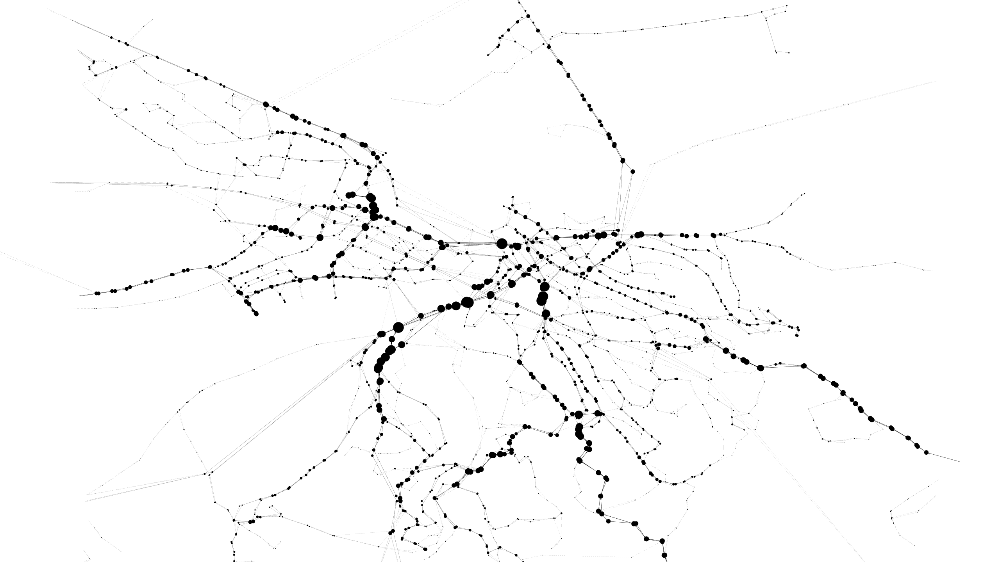

### 11) Da li mreža ispoljava fenomen kluba bogatih?


Koeficijent kluba bogatih se ne može izračunati za usmerene grafove.

Na osnovu proračuna gustine podgrafa čvorova većeg stepena zaključujemo da stanice sa većim stepenom teže da se povezuju jedna sa drugom ali ne u velikoj meri, što znači da ne ispunjava fenomen kluba bogatih u značajnoj meri.

In [ ]:
netLDegrees = nx.degree(netL, weight='weight')
richClubNetL = nx.subgraph(netL, [x for x in netL.nodes() if netLDegrees[x] > 20])

In [ ]:
richClubNetLDensity = nx.density(richClubNetL)
print(f'Rich Club Density: {richClubNetLDensity}')

### 12) Jezgro i periferija kod tarifnih zona


Sledeća slika je napravljena korišćenjem yifan hu algoritma na graf sa nasumičnim pozicijama čvorova. \
Može se videti da se i na taj način dobija gušće povezano jezgro sačinjeno od narandžastih čvorova prve zone, i slabije povezana periferija ljubičastih čvorova druge zone, zajedno sa par zelenih čvorova treće zone.

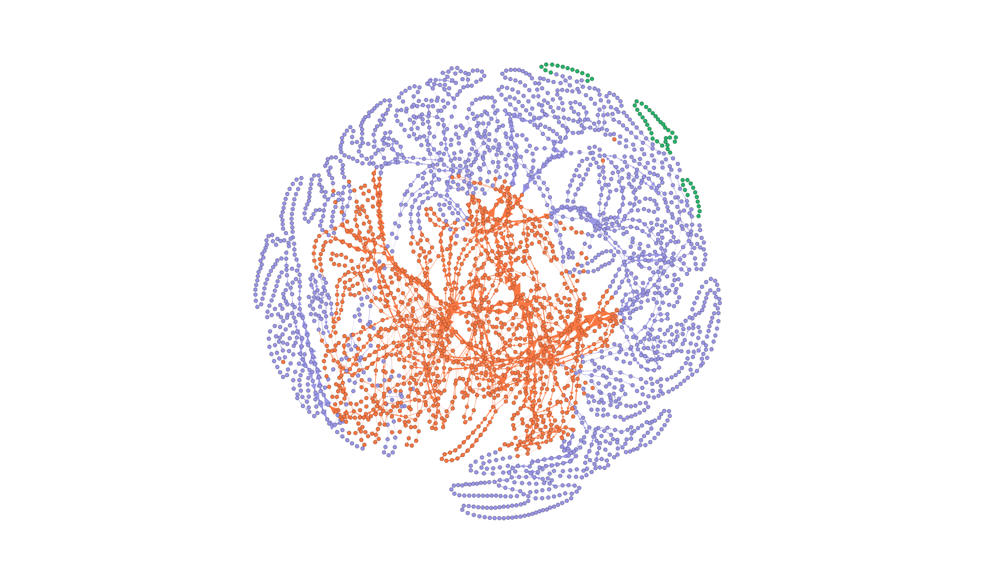

### 13) Distribucija čvorova po stepenu

Mreža prati truncated power law raspodelu za xmin=16, s obzirom da velika većina čvorova ima stepen ispod 16, zaključujemo da nije u pitanju scale free mreža.

In [ ]:
def plot_deg_frequency(G, weighted = False, xscale = "log", yscale = "log"):
  if weighted:
    degrees = G.degree(weight="weight")
  else:
    degrees = G.degree()
      
  _, deg_list = zip(*degrees)
  deg_counts = Counter(deg_list)
  print(deg_counts)
  x, y = zip(*deg_counts.items())

  plt.figure(1)

  if weighted:
    plt.xlabel('weighted degree')  
  else:
    plt.xlabel('degree')

  plt.xscale(xscale)
  plt.xlim(1, max(x))

  plt.ylabel('frequency')
  plt.yscale(yscale)
  plt.ylim(1, max(y))

  plt.scatter(x, y, marker='.')
  plt.show()

In [ ]:
plot_deg_frequency(netL, xscale='linear', yscale='linear')

In [ ]:
plot_deg_frequency(netL, weighted=True, xscale='linear', yscale='linear')

In [ ]:
degree_sequence = sorted([d for n, d in netL.degree(weight='weight')], reverse=True)

fit = powerlaw.Fit(degree_sequence)
print(f'Using xmin={fit.find_xmin()}')

fig2 = fit.plot_pdf(color='b', linewidth=2)
fit.power_law.plot_pdf(color='g', linestyle='--', ax=fig2)

In [ ]:
R, p = fit.distribution_compare('power_law', 'exponential', normalized_ratio=True)
print (R, p)

## Analiza mera centralnosti


In [ ]:
def print_centrality(dict, printCount=10):
  stopsWithCentrality = stops.copy()
  stopsWithCentrality['Centrality'] = stops['stop_id'].map(dict)
  display(stopsWithCentrality.sort_values(by='Centrality', ascending=False).head(printCount))

### 14) Analize centralnosti po stepenu, bliskosti i relacionoj centralnosti

In [ ]:
netLStopDegrees = dict(netL.degree(weight='weight'))
print_centrality(netLStopDegrees, 7)

In [ ]:
netLStopCloseness = nx.closeness_centrality(netL)
print_centrality(netLStopCloseness, 8)

In [ ]:
netLStopBetweenness = nx.betweenness_centrality(netL)
print_centrality(netLStopBetweenness, 7)

###15) Ko su najvažniji akteri po centralnosti po sopstvenom vektoru

Ovo su čvorovi koji su povezani sa više drugih dobro povezanih čvorova.

In [ ]:
netLStopEigenvector = nx.eigenvector_centrality(netL, max_iter=1000, weight='weight')
print_centrality(netLStopEigenvector, 8)

### 16) Mrežna heuristika

Za metriku je izabrana vrednost dobijena množenjem relacione centralnosti i Eigenvektor centralnosti po sopstvenom vektoru zato što smatramo da je za stanicu bitno da ima moćne susede i da se nalazi na ključnim putevima.

In [ ]:
stopsWithMergedCentrality = stops.copy()
stopsWithMergedCentrality['Centrality'] = stops['stop_id'].map(netLStopBetweenness) * stops['stop_id'].map(netLStopEigenvector)
display(stopsWithMergedCentrality.sort_values(by='Centrality', ascending=False).head(6))

## Detekcija komuna Luvenskom metodom

### 17) Klasterisanje Luvenskom metodom

Sa većim parametrom rezolucije dobija se manji broj većih komuna. \
Rezoluciju smo birali na taj način da dobijemo podele koje po redu veličine odgovaraju podelama grada na obale, opštine, i na naselja.

Resolution: 1.0
Modularity: 0.894
Communities: 39

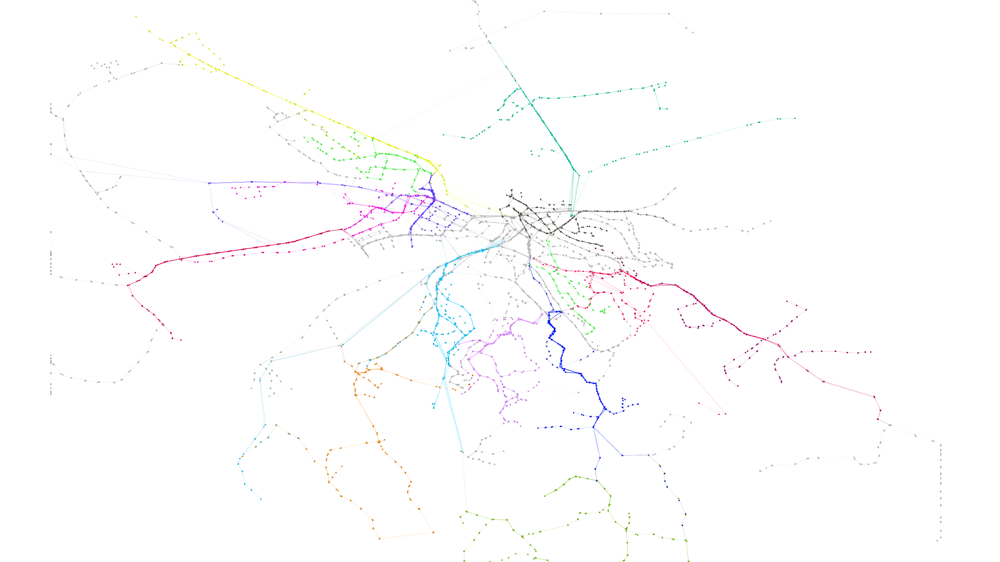

Resolution: 5.0
Modularity: 0.831
Communities: 10



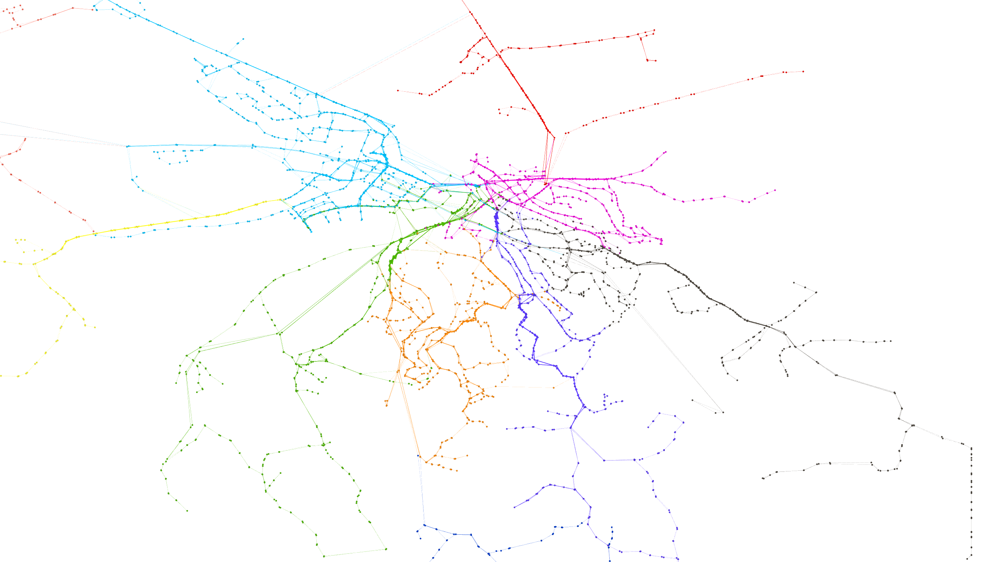

Resolution: 25.0
Modularity: 0.650
Communities: 3

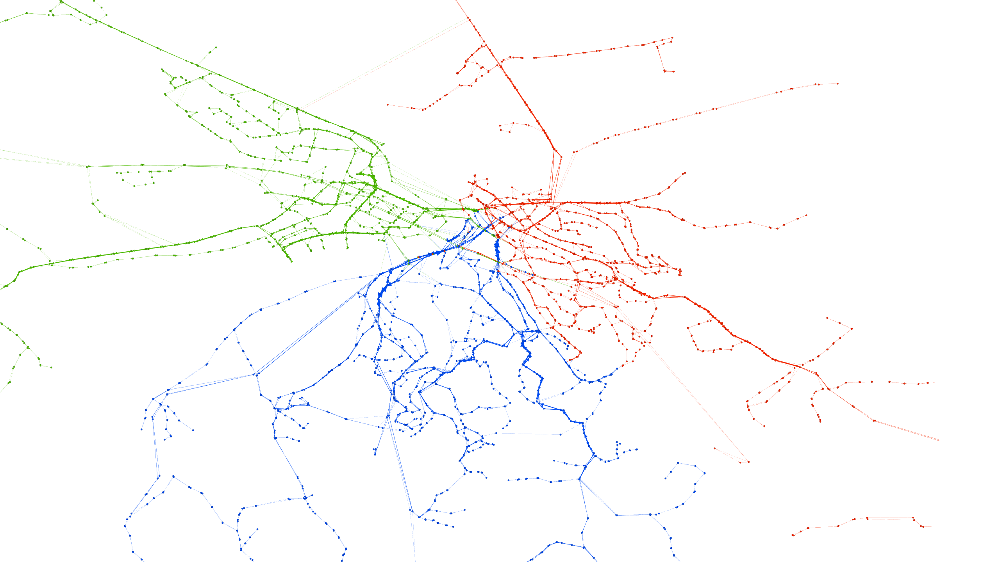

### 18) Analiza klasterisanja

Koje zajednice (komune) se mogu uočiti prilikom analize mreže?
* Može se primetiti da u prvoj podeli u najgušće naseljenim delovima grada, Centar i Novi Beograd, imamo podelu na veći broj manjih komuna. Dok u periferiji možemo primetiti da je podela nastala na osnovu naselja i ključnih saobraćajnica.
* Kod druge podele postoji veći akcenat na tim ključnim sobraćajnicama i načinu na koje one povezuju periferiju sa jezgrom.
* Treća podela pokazuje veliki uticaj reke Save i autoputa na podelu grada, jer se sav saobraćaj sliva preko samo par mostova što negativno utiče na povezanost grada.

Koji akteri su ključni brokeri? \\
Ključni brokeri su stanice koje se nalaze u blizini mostova, kao što su Radnička i Mostarska petlja, Autokomanda, Brankov most, i Zeleni venac, kao i velika čvorišta kao što su Slavija, i ponovo Zeleni Venac.

# **BGNetP Analiza**

## Osnovna karakterizacija

### 5) Gustina mreže

In [ ]:
netPDensity = nx.density(netP)
print(f'Density: {netPDensity}')

Gustina mreže je mala, iako zbog velikog broja čvorova izgleda dosta gusto. \\
Links per node metrika joj je 52.

### 6) Prosečne distance i dijametar mreže

In [ ]:
netPAverageDistance = nx.average_shortest_path_length(netP)
netPDiameter = nx.diameter(netP)

print(f'Average distance: {netPAverageDistance}')
print(f'Diameter: {netPDiameter}')

### 7) Broj i veličine povezanih komponenti

In [ ]:
print(f'Is connected: {nx.is_connected(netP)}')
print(f'Number of connected components: {nx.number_connected_components(netP)}')

Mreža je povezan, broj komponenti 1. Pre izbacivanja nepovezanih stanica broj komponenata je bio 7, gde je jedna bila gigantska komponenta.

### 8) a) Koliki je prosečni, a koliki globalni koeficijent klasterizacije mreže?

In [ ]:
netPAverageClustering = nx.average_clustering(netP, weight='weight')
netPGlobalClustering = nx.transitivity(netP)

print(f'Average clustering: {netPAverageClustering}')
print(f'Global clustering: {netPGlobalClustering}')

### 8) b) Kakva je raspodela lokalnog koeficijenta klasterizacije njenih čvorova?

In [ ]:
def plot_clustering(G, weighted = False, logScale = False):
  if weighted:
      clustering = nx.clustering(G, weight="weight")
  else:
      clustering = nx.clustering(G)
      
  for key, value in clustering.items():
    clustering[key] = math.floor(value * 40) / 40

  clust_counts = Counter(clustering.values())
  print(clust_counts)
  x, y = zip(*clust_counts.items())

  plt.ylabel('frequency')
  if weighted:
    plt.xlabel('weighted clustering')
  else:
    plt.xlabel('clustering') 

  plt.bar(clust_counts.keys(), clust_counts.values(), 0.025, align='edge', color='darkred', log=logScale, edgecolor="black")

In [ ]:
plot_clustering(netP, weighted = True, logScale = True)

### 8) c) Da li je klasterisanje izraženo ili ne? (U poređenju sa Erdos-Renyi modelom)

Maksimalan broj grana je $M =  \frac{n*(n-1)}{2} $  
Mi imamo $m$ grana  
$ p * M = m \Rightarrow p = \frac{m}{M} = \frac{2m}{n*(n-1)}$  

In [ ]:
n = netP.number_of_nodes()
m = netP.number_of_edges()
p = ( 2*float(m) ) / ( n* (n-1) )

netPER = nx.erdos_renyi_graph(n,p)
netPSFMulti = nx.scale_free_graph(n)

netPSF = nx.Graph()
for u,v in netPSFMulti.edges():
    if netPSF.has_edge(u,v):
        netPSF[u][v]['weight'] += 1
    else:
        netPSF.add_edge(u, v, weight=1)

In [ ]:
netPERAverageClustering = nx.average_clustering(netPER)
netPSFAverageClustering = nx.average_clustering(netPSF)

print(f'ER Average clustering: {netPERAverageClustering}')
print(f'SF Average clustering: {netPSFAverageClustering}')

Prosečni koeeficijent klasterizacije je istog reda veličine kao i erdoš-renijev model, što sugeriše da je mreža slabo klasterisana.

### 9) Da li iskazuje osobine malog sveta:
S obzirom na dijametar mreže (7), malih prosečnih udaljenosti (3), i globalni koeficijent klasterizacije (0.45), mreža definitivno iskazuje osobine malog sveta.

### 10) Asortativna analiza po stepenu čvora. Da li je izraženo asortativno mešanje?

Asortativnost (eng. assortativity) meri stepen tendencije čvorova mreže da se vezuju sa sličnim čvorovima.

In [ ]:
netPUWAssortativity = nx.degree_assortativity_coefficient(netP)
print(f"Netežinski koeficijent asortativnosti: {netPUWAssortativity}")

netPWAssortativity = nx.degree_assortativity_coefficient(netP, weight='weight')
print(f"Težinski koeficijent asortativnosti: {netPWAssortativity}")

Mreža je neasortativna.

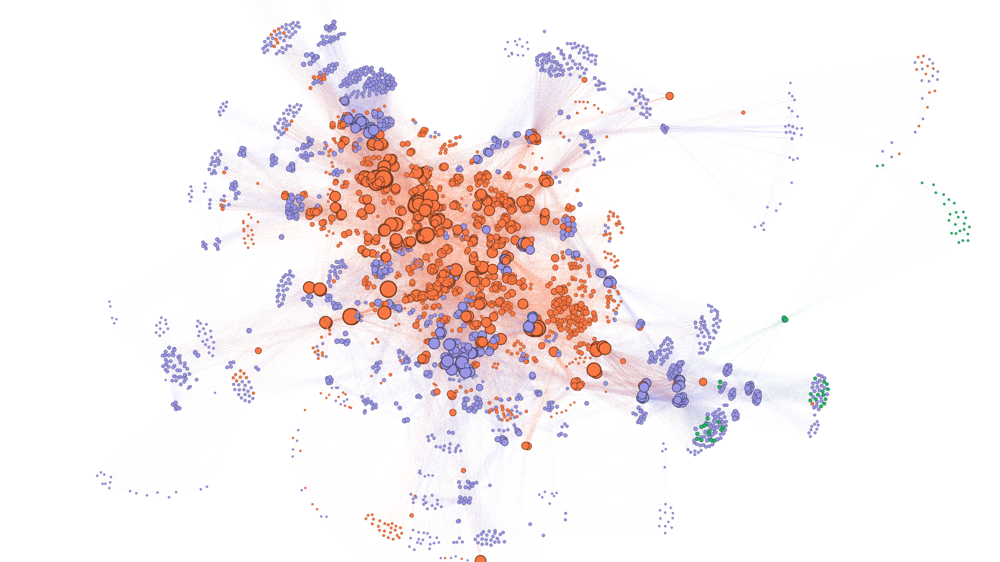

### 11) Da li mreža ispoljava fenomen kluba bogatih?


Networkx nije uspeo da izračuna koeficijent kluba bogatih.

Na osnovu proračuna gustine podgrafa čvorova većeg stepena zaključujemo da mreža ispoljava fenomen kluba bogatih.


In [ ]:
#nx.rich_club_coefficient(netP)

In [ ]:
netPDegrees = nx.degree(netP, weight='weight')
richClubNetP = nx.subgraph(netP, [x for x in netP.nodes() if netPDegrees[x] > 500])

In [ ]:
richClubNetPDensity = nx.density(richClubNetP)
print(f'Rich Club Density: {richClubNetPDensity}')

### 12) Jezgro i periferija kod tarifnih zona


Sledeća slika je napravljena korišćenjem yifan hu algoritma na graf sa nasumičnim pozicijama čvorova. \
Može se videti da se i na taj način dobija gušće povezano jezgro sačinjeno od narandžastih čvorova prve zone, i slabije povezana periferija ljubičastih čvorova druge zone, zajedno sa par zelenih čvorova treće zone.

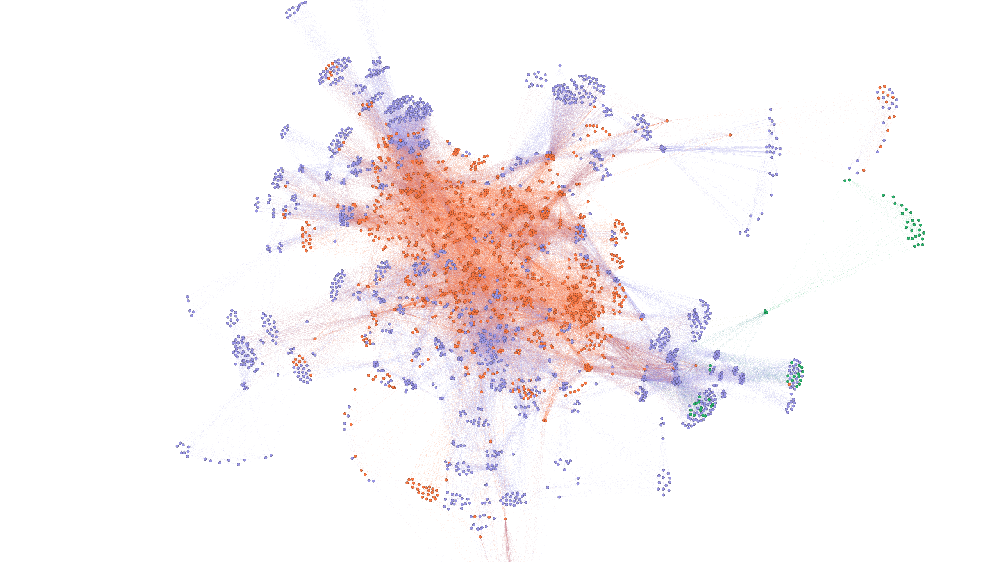

### 13) Distribucija čvorova po stepenu

Mreža prati truncated power law raspodelu za xmin=414, s obzirom da velika većina čvorova ima stepen ispod 414, zaključujemo da nije u pitanju scale free mreža.

In [ ]:
def plot_deg_frequency(G, weighted = False, logScale=False):
  if weighted:
    degrees = G.degree(weight="weight")
  else:
    degrees = G.degree()

  degrees = dict(degrees)

  for key, value in degrees.items():
    degrees[key] = value - value % 50

  deg_counts = Counter(degrees.values()) 
  print(deg_counts)
  x, y = zip(*deg_counts.items())                                                   

  plt.figure(1)

  plt.ylabel('frequency')
  if weighted:
    plt.xlabel('weighted degree')
  else:
    plt.xlabel('degree')

  plt.bar(deg_counts.keys(), deg_counts.values(), 50, align='edge', color='blue', log=logScale, edgecolor="black")

In [ ]:
plot_deg_frequency(netP, weighted=True)

In [ ]:
degree_sequence = sorted([d for n, d in netP.degree(weight='weight')], reverse=True)

fit = powerlaw.Fit(degree_sequence)
print(f'Using xmin={fit.find_xmin()}')

fig2 = fit.plot_pdf(color='b', linewidth=2)
fit.power_law.plot_pdf(color='g', linestyle='--', ax=fig2)

In [ ]:
R, p = fit.distribution_compare('power_law', 'exponential', normalized_ratio=True)
print (R, p)

## Analiza mera centralnosti


In [ ]:
def print_centrality(dict, printCount=10):
  stopsWithCentrality = stops.copy()
  stopsWithCentrality['Centrality'] = stops['stop_id'].map(dict)
  display(stopsWithCentrality.sort_values(by='Centrality', ascending=False).head(printCount))

### 14) Analize centralnosti po stepenu, bliskosti i relacionoj centralnosti

In [ ]:
netPStopDegrees = dict(netP.degree(weight='weight'))
print_centrality(netPStopDegrees, 6)

In [ ]:
netPStopCloseness = nx.closeness_centrality(netP)
print_centrality(netPStopCloseness, 10)

In [ ]:
netPStopBetweenness = nx.betweenness_centrality(netP)
print_centrality(netPStopBetweenness, 7)

###15) Ko su najvažniji akteri po centralnosti po sopstvenom vektoru

Ovo su čvorovi koji su povezani sa više drugih dobro povezanih čvorova.

In [ ]:
netPStopEigenvector = nx.eigenvector_centrality(netP, max_iter=100, weight='weight')
print_centrality(netPStopEigenvector, 5)

### 16) Mrežna heuristika

Za metriku je izabrana vrednost dobijena množenjem relacione centralnosti i Eigenvektor centralnosti po sopstvenom vektoru zato što smatramo da je za stanicu bitno da ima moćne susede i da se nalazi na ključnim presecima linija.

In [ ]:
stopsWithMergedCentrality = stops.copy()
stopsWithMergedCentrality['Centrality'] = stops['stop_id'].map(netPStopBetweenness) * stops['stop_id'].map(netPStopEigenvector)
display(stopsWithMergedCentrality.sort_values(by='Centrality', ascending=False).head(7))

## Detekcija komuna Luvenskom metodom

### 17) Klasterisanje Luvenskom metodom

Sa većim parametrom rezolucije dobija se manji broj većih komuna. \
Rezoluciju smo birali na taj način ta maksimizujemo modularnost za različit broj komuna. \
Po modularnosti se vidi da ova mreža nije prigodna za klasterisanje. Pogotovo sa rezolucijom preko 3 modularnost naglo pada.

Resolution: 1.0
Modularity: 0.634
Communities: 10

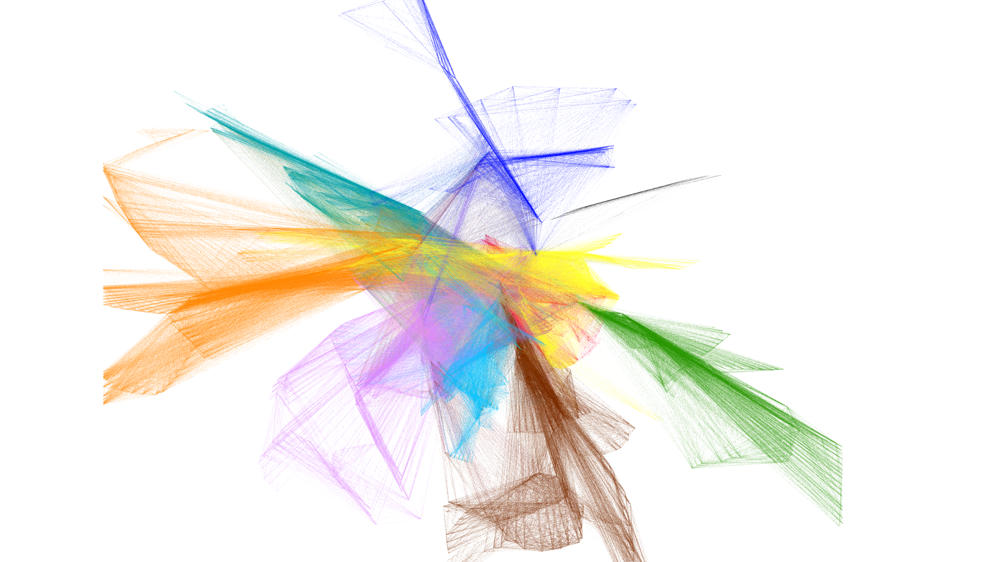

Resolution: 2.0
Modularity: 0.600
Communities: 6



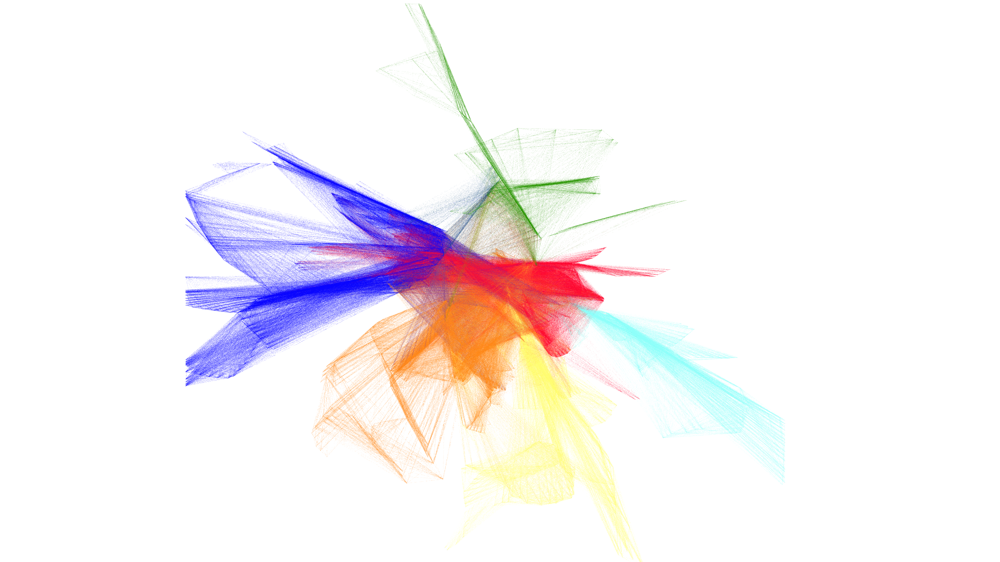

Resolution: 3.0
Modularity: 0.479
Communities: 4

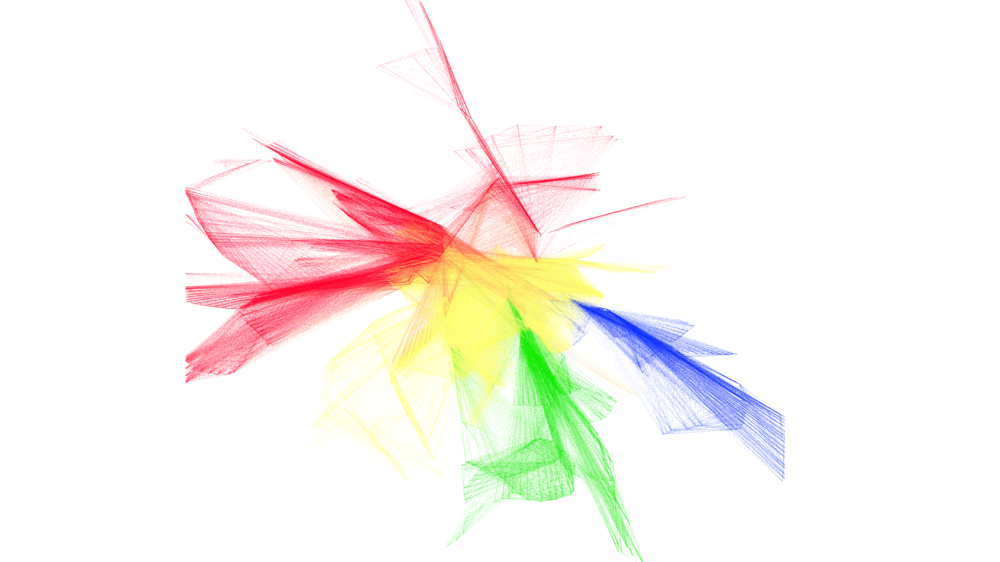

### 18) Analiza klasterisanja

Koje zajednice (komune) se mogu uočiti prilikom analize mreže? \
U NetP mreži najviše do izražaja dolaze ključne saobraćajnice jer one najviše povezuju različite rute.

Koji akteri su ključni brokeri? \
Zbog prirode same P mreže koja spaja sve stanice koje imaju zajedničku liniju, ne postoji specifičan tip brokera koji dolazi do izražaja. Na grafovima se može videti da se komune u velikoj meri prepliću.

# **BGNetC Analiza**

## Osnovna karakterizacija

### 5) Gustina mreže


In [ ]:
netCDensity = nx.density(netC)
print(f'Density: {netCDensity}')

### 6) Prosečne distance i dijametar mreže

In [ ]:
netCAverageDistance = nx.average_shortest_path_length(netC)
netCDiameter = nx.diameter(netC)

print(f'Average distance: {netCAverageDistance}')
print(f'Diameter: {netCDiameter}')

### 7) Broj i veličine povezanih komponenti

In [ ]:
print(f'Is connected: {nx.is_connected(netC)}')
print(f'Number of connected components: {nx.number_connected_components(netC)}')

### 8) a) Koliki je prosečni, a koliki globalni koeficijent klasterizacije mreže?

In [ ]:
netCAverageClustering = nx.average_clustering(netC, weight='weight')
netCGlobalClustering = nx.transitivity(netC)

print(f'Average clustering: {netCAverageClustering}')
print(f'Global clustering: {netCGlobalClustering}')

### 8) b) Kakva je raspodela lokalnog koeficijenta klasterizacije njenih čvorova?

In [ ]:
def plot_clustering(G, weighted = False, logScale = False):
  if weighted:
      clustering = nx.clustering(G, weight="weight")
  else:
      clustering = nx.clustering(G)
      
  for key, value in clustering.items():
    clustering[key] = round(value * 40) / 40

  clust_counts = Counter(clustering.values())
  print(clust_counts)
  x, y = zip(*clust_counts.items())

  plt.ylabel('frequency')
  if weighted:
    plt.xlabel('weighted clustering')
  else:
    plt.xlabel('clustering')                                             

  plt.bar(clust_counts.keys(), clust_counts.values(), 0.025, align='edge', color='darkred', log=logScale, edgecolor="black")

In [ ]:
plot_clustering(netC, weighted = True, logScale = False)

### 8) c) Da li je klasterisanje izraženo ili ne? (U poređenju sa Erdos-Renyi modelom)

Maksimalan broj grana je $M =  \frac{n*(n-1)}{2} $  
Mi imamo $m$ grana  
$ p * M = m \Rightarrow p = \frac{m}{M} = \frac{2m}{n*(n-1)}$ 

In [ ]:
n = netC.number_of_nodes()
m = netC.number_of_edges()
p = ( 2*float(m) ) / ( n* (n-1) )

netCER = nx.erdos_renyi_graph(n,p)
netCSFMulti = nx.scale_free_graph(n)

netCSF = nx.Graph()
for u,v in netCSFMulti.edges():
    if netCSF.has_edge(u,v):
        netCSF[u][v]['weight'] += 1
    else:
        netCSF.add_edge(u, v, weight=1)

In [ ]:
netCERAverageClustering = nx.average_clustering(netCER)
netCSFAverageClustering = nx.average_clustering(netCSF)

print(f'ER Average clustering: {netCERAverageClustering}')
print(f'SF Average clustering: {netCSFAverageClustering}')

Prosečni koeeficijent klasterizacije je manji od erdoš-renijevog i scale free modela, što sugeriše da je mreža slabo klasterisana.

### 9) Da li iskazuje osobine malog sveta:
S obzirom na dijametar mreže (6), i malih prosečnih udaljenosti (2), i globalnog koeficijenta klasterizacije (0.49), mreža definitivno iskazuje osobine malog sveta.

### 10) Asortativna analiza po stepenu čvora. Da li je izraženo asortativno mešanje?
Asortativnost (eng. assortativity) meri stepen tendencije čvorova mreže da se vezuju sa sličnim čvorovima.

Mreža je neasortativna.

In [ ]:
netCUWAssortativity = nx.degree_assortativity_coefficient(netC)
print(f"Netežinski koeficijent asortativnosti: {netCUWAssortativity}")

netCWAssortativity = nx.degree_assortativity_coefficient(netC, weight='weight')
print(f"Težinski koeficijent asortativnosti: {netCWAssortativity}")

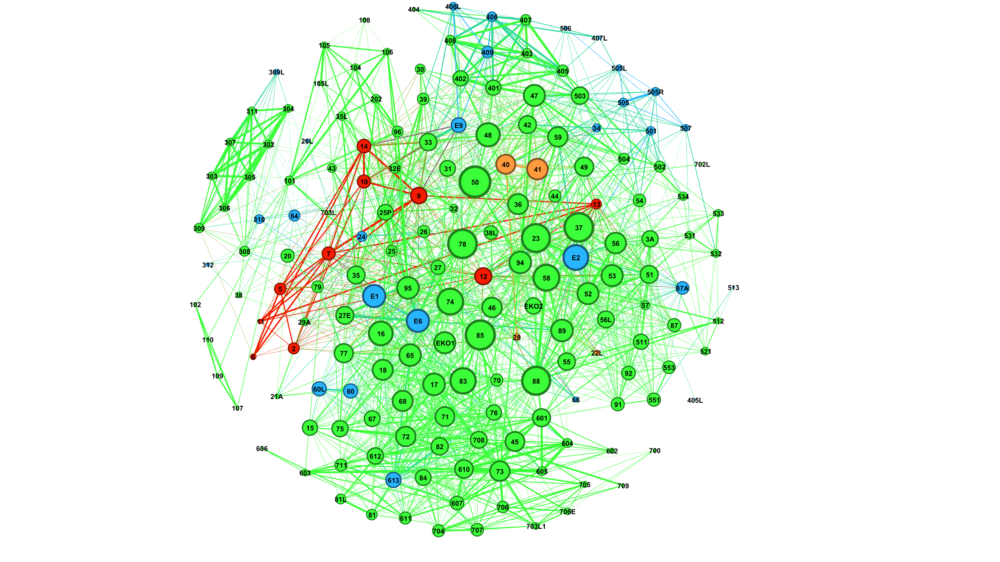

### 11) Da li mreža ispoljava fenomen kluba bogatih?


U ispisu ispod može se videti da gustina raste za podgrafe sa čvorova većeg stepena. Na osnovu toga zaključujemo da mreža ispoljava koeficijent kluba bogatih.

Funkcija rich_club_coefficient računa stepene bez težine. Radili smo ručno analize sa težinskim stepenima i primetili da se ponaša na isti način ali u manjoj meri.

In [ ]:
nx.rich_club_coefficient(netC, normalized=False)

### 13) Distribucija čvorova po stepenu

Mreža NE prati power law raspodelu, to jest NIJE pitanju scale free mreža.

In [ ]:
def plot_deg_frequency(G, weighted = False, logScale=False):
  if weighted:
    degrees = G.degree(weight="weight")
  else:
    degrees = G.degree()

  degrees = dict(degrees)

  for key, value in degrees.items():
    degrees[key] = value - value % 50

  deg_counts = Counter(degrees.values()) 
  print(deg_counts)
  x, y = zip(*deg_counts.items())                                                   

  plt.figure(1)

  plt.ylabel('frequency')
  if weighted:
    plt.xlabel('weighted degree')
  else:
    plt.xlabel('degree')

  plt.bar(deg_counts.keys(), deg_counts.values(), 50, align='edge', color='blue', log=logScale, edgecolor="black")

In [ ]:
plot_deg_frequency(netC, weighted=True)

In [ ]:
degree_sequence = sorted([d for n, d in netC.degree(weight='weight')], reverse=True)

fit = powerlaw.Fit(degree_sequence)
print(f'Using xmin={fit.find_xmin()}')

fig2 = fit.plot_pdf(color='b', linewidth=2)
fit.power_law.plot_pdf(color='g', linestyle='--', ax=fig2)

In [ ]:
R, p = fit.distribution_compare('power_law', 'exponential', normalized_ratio=True)
print (R, p)

## Analiza mera centralnosti

In [ ]:
def print_centrality(dict, printCount=10):
  routedWithCentrality = routes.copy()
  routedWithCentrality['route_id'] = routedWithCentrality['route_id'] + routeOffset
  routedWithCentrality['Centrality'] = routedWithCentrality['route_id'].map(dict)
  display(routedWithCentrality[['route_short_name', 'route_long_name', 'route_type', 'Centrality']].sort_values(by='Centrality', ascending=False).head(printCount))

### 14) Analize centralnosti po stepenu, bliskosti i relacionoj centralnosti

In [ ]:
netCRouteDegrees = dict(netC.degree)
print_centrality(netCRouteDegrees, 10)

In [ ]:
netCSRouteloseness = nx.closeness_centrality(netC)
print_centrality(netCSRouteloseness, 8)

In [ ]:
netCRouteBetweenness = nx.betweenness_centrality(netC)
print_centrality(netCRouteBetweenness, 5)

###15) Ko su najvažniji akteri po centralnosti po sopstvenom vektoru

Ovo su čvorovi koji su povezani sa više drugih dobro povezanih čvorova.

In [ ]:
netCRouteEigenvector = nx.eigenvector_centrality(netC)
print_centrality(netCRouteEigenvector, 6)

### 16) Mrežna heuristika

Za metriku je izabrana vrednost dobijena množenjem relacione centralnosti i Eigenvektor centralnosti po sopstvenom vektoru zato što smatramo da je za rutu bitno da se nalazi na ključnim putevima između ruta, i da može sa nje da se preseda na druge moćne rute.

In [ ]:
routesWithMergedCetrality = routes.copy()
routesWithMergedCetrality['route_id'] = routesWithMergedCetrality['route_id'] + routeOffset
routesWithMergedCetrality['Centrality'] = (routesWithMergedCetrality['route_id'].map(netCRouteBetweenness) * routesWithMergedCetrality['route_id'].map(netCRouteEigenvector)) * 100
display(routesWithMergedCetrality[['route_short_name', 'route_long_name', 'route_type', 'Centrality']].sort_values(by='Centrality', ascending=False).head(5))

## Detekcija komuna Luvenskom metodom

### 17) Klasterisanje Luvenskom metodom

Sa većim parametrom rezolucije dobija se manji broj većih komuna. \
Rezoluciju smo birali na taj način ta maksimizujemo modularnost za različit broj komuna. \
Po modularnosti se vidi da ova mreža nije prigodna za klasterisanje. Pogotovo sa rezolucijom preko 3 modularnost naglo pada.

Resolution: 1.0
Modularity: 0.569
Communities: 6

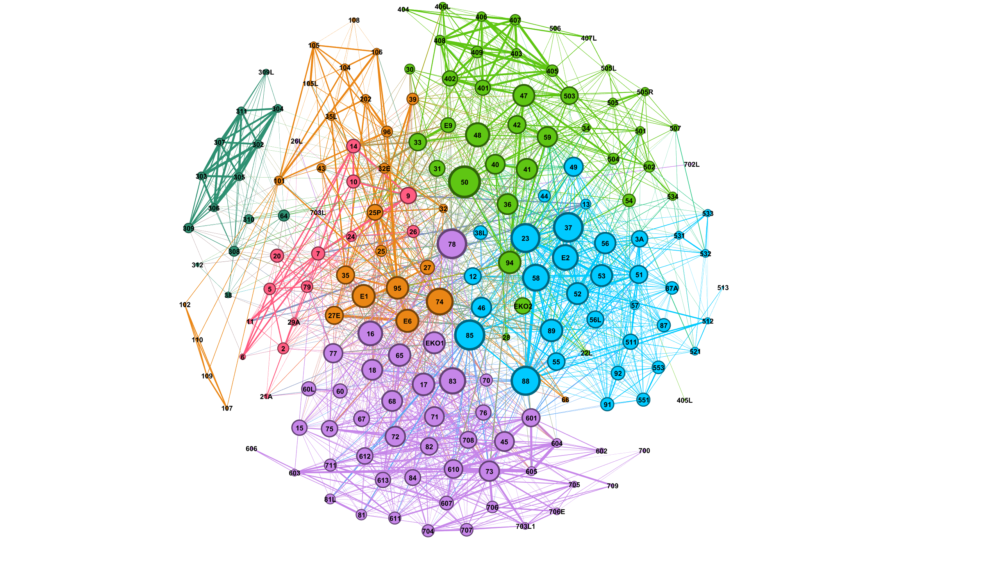

Resolution: 2.0
Modularity: 0.564
Communities: 4



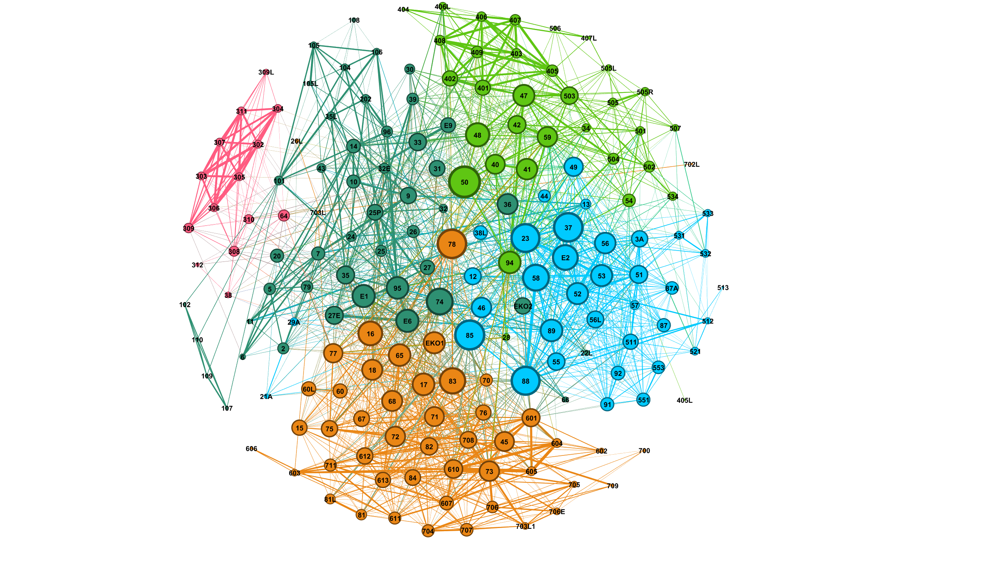

Resolution: 2.0
Modularity: 0.446
Communities: 3

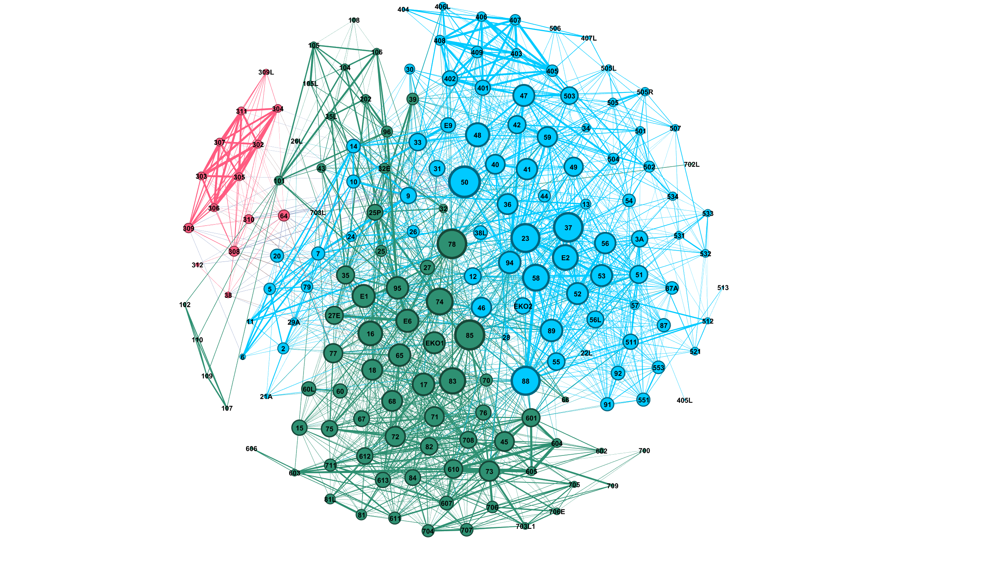

### 18) Analiza klasterisanja

Koje zajednice (komune) se mogu uočiti prilikom analize mreže? \
Kraće rute i rute sa manjim stepenom čvora čine komune po tome kroz koje delove grada prolaze, a veće rute se vezuju za te komune.

Koji akteri su ključni brokeri? \
Ključni brokeri su duže rute sa većim stepenom čvora.

# **BGNetLWalk Analiza**

## Osnovna karakterizacija

### 5) Gustina mreže
Mreža je veoma retka

In [ ]:
netLWalkDensity = nx.density(netLWalk)
print(f'Density: {netLWalkDensity}')

**BGNetL vs. BGNetLWalk** \\
BGNetLWalk mreža je duplo gušća od BGNetL zbog dodatih grana kojima može da se pešači ali je i dalje gustina jako retka.

### 6) Prosečne distance i dijametar mreže

In [ ]:
netLWalkAverageDistance = nx.average_shortest_path_length(netLWalk)
netLWalkDiameter = nx.diameter(netLWalk)

print(f'Average distance: {netLWalkAverageDistance}')
print(f'Diameter: {netLWalkDiameter}')

**BGNetL vs. BGNetLWalk** \\
Prosečna distanca između stanica je opala u BGNetLWalk mreži, jer su dodate veze kojima je moguće ići pešaka. Dijametar je takođe opao jer su sada najudaljenije stanice dostižnije jer je moguće pešačenjem lakše presedati i ići kraćim putem.

### 7) Broj i veličine povezanih komponenti
Mreža je jako povezana tako da je broj komponenti 1. Pre izbacivanja nepovezanih stanica broj komponenata je bio 7, gde je jedna bila gigantska komponenta.

In [ ]:
print(f'Is strongly connected: {nx.is_strongly_connected(netLWalk)}')
print(f'Number of strongly connected components: {nx.number_strongly_connected_components(netLWalk)}')

### 8) a) Koliki je prosečni, a koliki globalni koeficijent klasterizacije mreže?

In [ ]:
netLWalkAverageClustering = nx.average_clustering(netLWalk, weight='weight')
netLWalkGlobalClustering = nx.transitivity(netLWalk)

print(f'Average clustering: {netLWalkAverageClustering}')
print(f'Global clustering: {netLWalkGlobalClustering}')

**BGNetL vs. BGNetLWalk** \\
Koeficijenti klasterizacije BGNetLWalk mreže su veći, zbog veće gustine, oko 7-8 puta u odnosu na BGNetL mrežu ali je mreža i dalje slabo klasterisana.

### 8) b) Kakva je raspodela lokalnog koeficijenta klasterizacije njenih čvorova?
Velika većina čvorova ima koeficijent klasterizacije 0.

In [ ]:
def plot_clustering(G, weighted = False, logScale = False):
  if weighted:
      clustering = nx.clustering(G, weight="weight")
  else:
      clustering = nx.clustering(G)
      
  for key, value in clustering.items():
    clustering[key] = round(value * 40) / 40

  clust_counts = Counter(clustering.values())
  print(clust_counts)
  x, y = zip(*clust_counts.items())

  plt.ylabel('frequency')
  if weighted:
    plt.xlabel('weighted clustering')
  else:
    plt.xlabel('clustering')                                             

  plt.bar(clust_counts.keys(), clust_counts.values(), 0.025, align='edge', color='darkred', log=logScale, edgecolor="black")

In [ ]:
plot_clustering(netLWalk, weighted = True, logScale = True)

**BGNetL vs. BGNetLWalk** \\
Pojedinačni čvorovi imaju malo veći lokalni koeficijent klasterizacije u odnosu na BGNetL mrežu ali ne nešto previše.

### 8) c) Da li je klasterisanje izraženo ili ne? (U poređenju sa Erdos-Renyi modelom)

Maksimalan broj grana je $M =  \frac{n*(n-1)}{2} $  
Mi imamo $m$ grana  
$ p * M = m \Rightarrow p = \frac{m}{M} = \frac{2m}{n*(n-1)}$  

In [ ]:
n = netLWalk.number_of_nodes()
m = netLWalk.number_of_edges()
p = ( 2*float(m) ) / ( n* (n-1) )

netLWalkER = nx.erdos_renyi_graph(n,p)
netLWalkSFMulti = nx.scale_free_graph(n)

netLWalkSF = nx.DiGraph()
for u,v in netLWalkSFMulti.edges():
    if netLWalkSF.has_edge(u,v):
        netLWalkSF[u][v]['weight'] += 1
    else:
        netLWalkSF.add_edge(u, v, weight=1)

In [ ]:
netLWalkERAverageClustering = nx.average_clustering(netLWalkER)
netLWalkSFAverageClustering = nx.average_clustering(netLWalkSF)

print(f'ER Average clustering: {netLWalkERAverageClustering}')
print(f'SF Average clustering: {netLWalkSFAverageClustering}')

Prosečni koeeficijent klasterizacije je istog reda veličine kao i erdoš-renijev model, što sugeriše da je mreža slabo klasterisana.

**BGNetL vs. BGNetLWalk** \\
Koeficijenti BGNetLWalk mreže su malo veći u odnosu na BGNetL mrežu ali je mreža i dalje slabo klasterisana.

### 9) Da li iskazuje osobine malog sveta:
S obzirom na velike razdaljine i mali globalni koeficijent klasterizacije, mreža ne pokazuje osobine malog sveta.

### 10) Asortativna analiza po stepenu čvora. Da li je izraženo asortativno mešanje?
Asortativnost (eng. assortativity) meri stepen tendencije čvorova mreže da se vezuju sa sličnim čvorovima.

Netežinski gledano, mreža je jako asortativna, a težinski gledano je srednje asortativna.

**BGNetL vs. BGNetLWalk** \\
Mreža BGNetLWalk je netežinski gledano jako asortativna za razliku od BGNetL mreže koja je slabo asortativna. Razlog za to su skupovi bliskih stanice, koje su zbog pešačkog povezivanja postale jake i međusobno povezane.

In [ ]:
netLWalkUWAssortativity = nx.degree_assortativity_coefficient(netLWalk)
print(f"Netežinski koeficijent asortativnosti: {netLWalkUWAssortativity}")

netLWalkWAssortativity = nx.degree_assortativity_coefficient(netLWalk, weight='weight')
print(f"Težinski koeficijent asortativnosti: {netLWalkWAssortativity}")

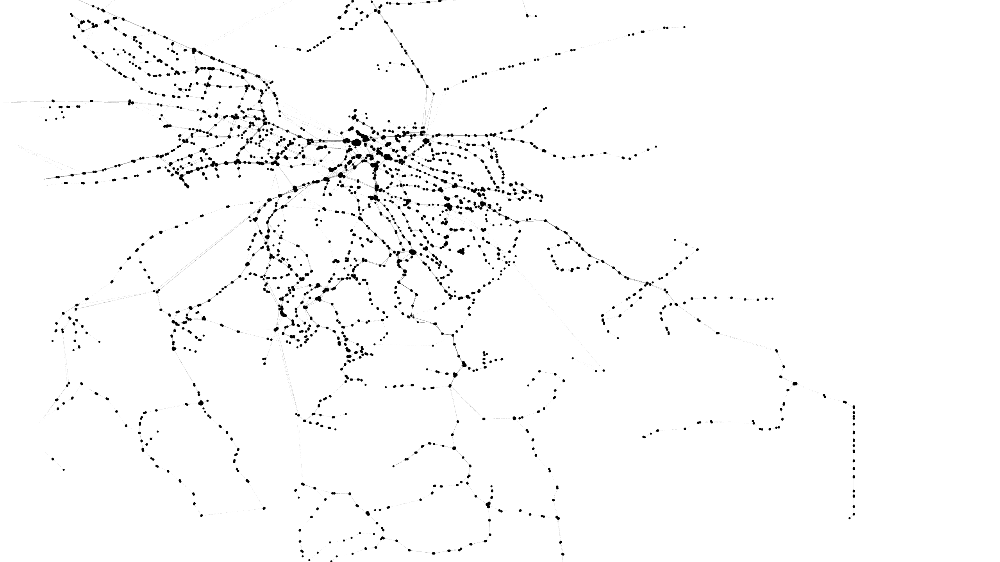

### 11) Da li mreža ispoljava fenomen kluba bogatih?


Koeficijent kluba bogatih se ne može izračunati za usmerene grafove.

Na osnovu proračuna gustine podgrafa čvorova većeg stepena zaključujemo da stanice sa većim stepenom teže da se povezuju jedna sa drugom ali ne u velikoj meri, što znači da ne ispunjava fenomen kluba bogatih u značajnoj meri.

In [ ]:
netLWalkDegrees = nx.degree(netLWalk, weight='weight')
richClubNetLWalk = nx.subgraph(netLWalk, [x for x in netLWalk.nodes() if netLWalkDegrees[x] > 20])

In [ ]:
netLWalkDensity = nx.density(richClubNetLWalk)
print(f'Rich Club Density: {netLWalkDensity}')

### 12) Jezgro i periferija kod tarifnih zona


Sledeća slika je napravljena korišćenjem yifan hu algoritma na graf sa nasumičnim pozicijama čvorova. \
Može se videti da postoji bolje povezano jezgro i slabije povezana periferija, ali se u slučaju Walk mreže to jezgro ne poklapa potpuno sa prvom tarifnom zonom, jer su sada stanice u zonama 2 i 3 mnogo bolje povezane.

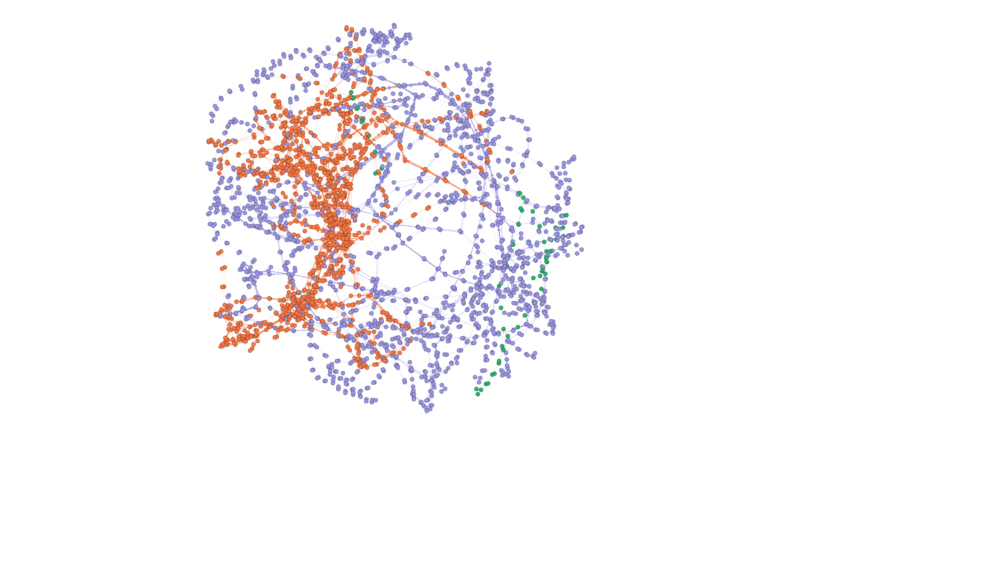

**BGNetL vs. BGNetLWalk** \\
U BgNetLWalk mreži su i dalje izraženi jezgro i periferija ali slabije nego što je to kod mreže BGNetL. Razlog za to je što su stanice na periferiji bolje povezane zbog pešačke veze.

### 13) Distribucija čvorova po stepenu

Mreža prati truncated power law raspodelu za xmin=24, s obzirom da velika većina čvorova ima stepen ispod 24, zaključujemo da nije u pitanju scale free mreža.

In [ ]:
def plot_deg_frequency(G, weighted = False, logScale=False):
  if weighted:
    degrees = G.degree(weight="weight")
  else:
    degrees = G.degree()

  degrees = dict(degrees)

  for key, value in degrees.items():
    degrees[key] = value - value % 5

  deg_counts = Counter(degrees.values()) 
  print(deg_counts)
  x, y = zip(*deg_counts.items())                                                   

  plt.figure(1)

  plt.ylabel('frequency')
  if weighted:
    plt.xlabel('weighted degree')
  else:
    plt.xlabel('degree')

  plt.bar(deg_counts.keys(), deg_counts.values(), 5, align='edge', color='blue', log=logScale, edgecolor="black")

In [ ]:
plot_deg_frequency(netLWalk, weighted=True,)

In [ ]:
degree_sequence = sorted([d for n, d in netLWalk.degree(weight='weight')], reverse=True)

fit = powerlaw.Fit(degree_sequence)
print(f'Using xmin={fit.find_xmin()}')

fig2 = fit.plot_pdf(color='b', linewidth=2)
fit.power_law.plot_pdf(color='g', linestyle='--', ax=fig2)

In [ ]:
R, p = fit.distribution_compare('power_law', 'exponential', normalized_ratio=True)
print (R, p)

## Analiza mera centralnosti


In [ ]:
def print_centrality(dict, printCount=10):
  stopsWithCentrality = stops.copy()
  stopsWithCentrality['Centrality'] = stops['stop_id'].map(dict)
  display(stopsWithCentrality.sort_values(by='Centrality', ascending=False).head(printCount))

### 14) Analize centralnosti po stepenu, bliskosti i relacionoj centralnosti

In [ ]:
netLWalkStopDegrees = dict(netLWalk.degree(weight='weight'))
print_centrality(netLWalkStopDegrees, 7)

**BGNetL vs. BGNetLWalk** \\
U BGNetLWalk mreži najveću centralnost imaju Brankov Most(cent=42) i Zeleni Venac(cent=41) dok u BGNetL mreži najveću centralnost imaju Sajam(cent=34) i Ada Ciganlija(cent=34). Razlog za to je veliki broj stanica koji se nalazi na lokaciji Zeleni Venac koje nisu bile povezane u mreži BGNetL, kojima je sada drastično skočio stepen zato što su u BGNetLWalk mreži povezane pešačkim putem. 

In [ ]:
netLWalkStopCloseness = nx.closeness_centrality(netLWalk)
print_centrality(netLWalkStopCloseness, 8)

In [ ]:
netLWalkStopBetweenness = nx.betweenness_centrality(netLWalk)
print_centrality(netLWalkStopBetweenness, 7)

###15) Ko su najvažniji akteri po centralnosti po sopstvenom vektoru

Ovo su čvorovi koji su povezani sa više drugih dobro povezanih čvorova.

In [ ]:
netLWalkStopEigenvector = nx.eigenvector_centrality(netLWalk, max_iter=600, weight='weight')
print_centrality(netLWalkStopEigenvector, 13)

**BGNetL vs. BGNetLWalk** \\
Zeleni Venac je postao apsolutno dominantan zbog toga što je veliki broj stanica koji se nalazi relativno blizu sada spojen.

### 16) Mrežna heuristika

Za metriku je izabrana vrednost dobijena množenjem relacione centralnosti i Eigenvektor centralnosti po sopstvenom vektoru zato što smatramo da je za stanicu bitno da ima moćne susede i da se nalazi na ključnim putevima.

In [ ]:
stopsWalkWithMergedCentrality = stops.copy()
stopsWalkWithMergedCentrality['Centrality'] = stops['stop_id'].map(netLWalkStopBetweenness) * stops['stop_id'].map(netLWalkStopEigenvector)
display(stopsWalkWithMergedCentrality.sort_values(by='Centrality', ascending=False).head(7))

**BGNetL vs. BGNetLWalk** \\
Iz istog gore navedenog razloga opet je dominantan Zeleni Venac.

## Detekcija komuna Luvenskom metodom

### 17) Klasterisanje Luvenskom metodom

Sa većim parametrom rezolucije dobija se manji broj većih komuna. \
Rezoluciju smo birali na taj način da dobijemo podele koje po redu veličine odgovaraju podelama grada na obale, opštine, i na naselja.

Resolution: 1.0
Modularity: 0.894
Communities: 39

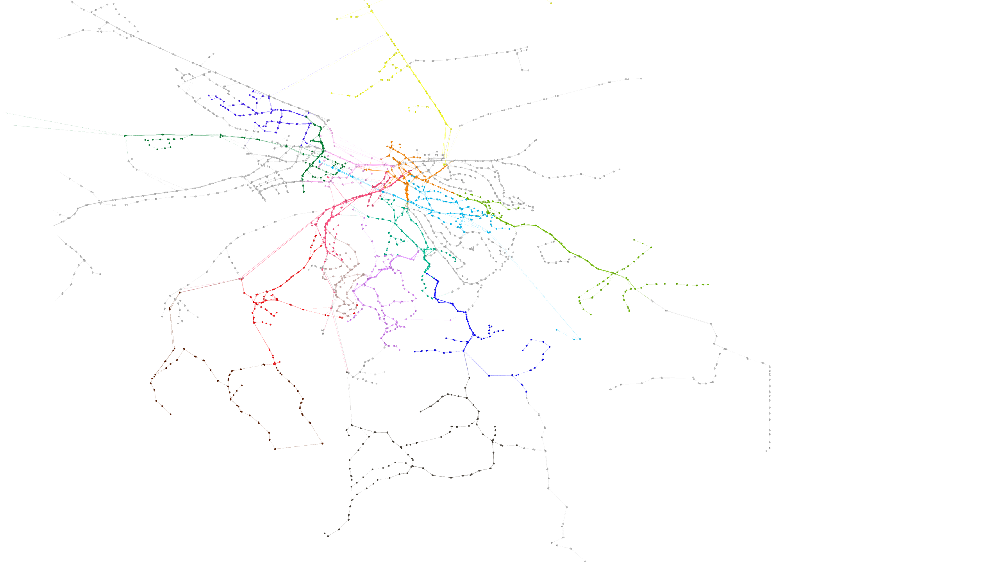

**BGNetL vs. BGNetLWalk** \\
Dobijen je isti broj komuna i modularnost kao kod mreže BGNetL sa tim što se komune blago razlikuju. Veće komune koje se sada izdvajaju su u centru grada jer je centar bolje povezan zbog mogućeg pešačenja između stanica.

Resolution: 5.0
Modularity: 0.844
Communities: 11



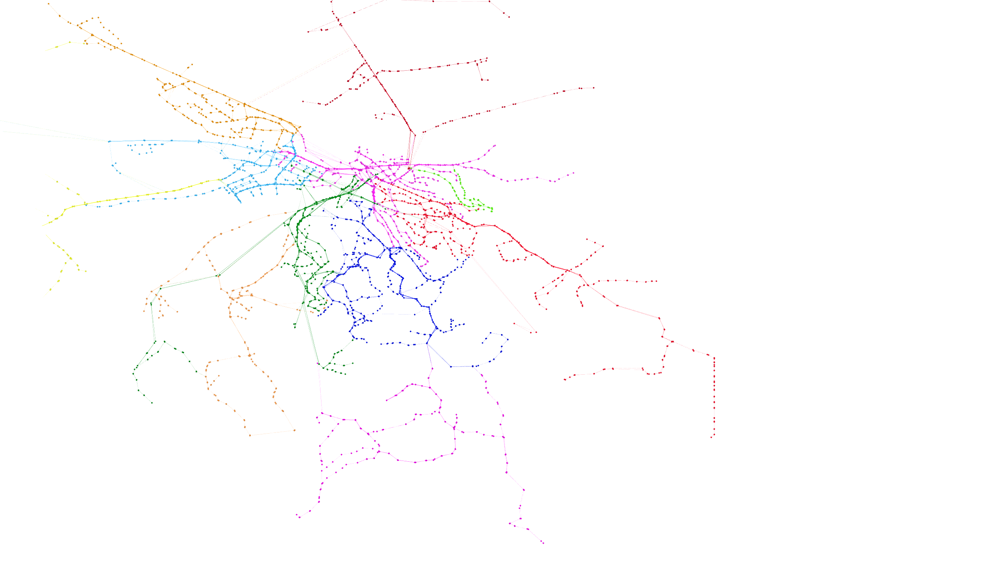

Resolution: 25.0
Modularity: 0.59
Communities: 4

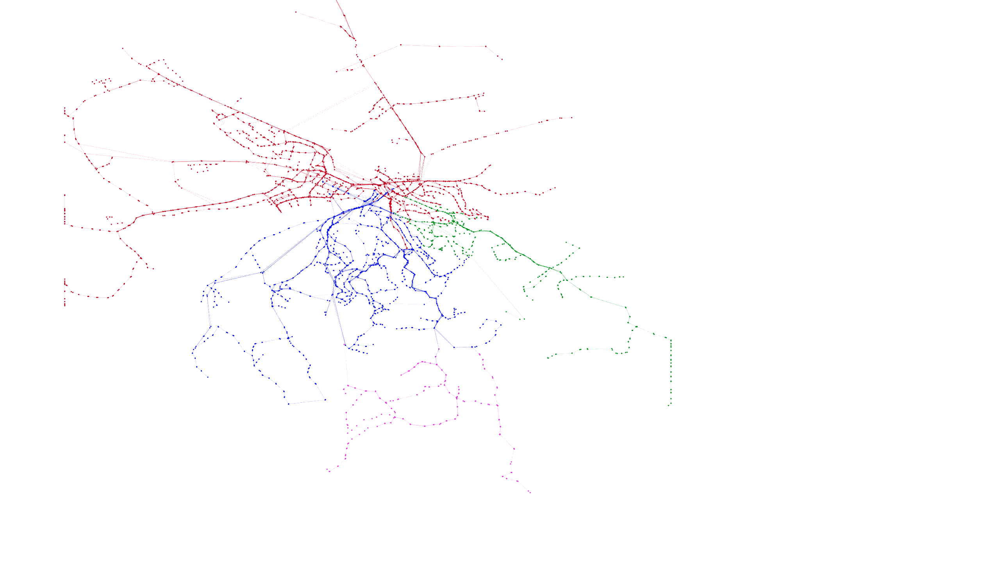

**BGNetL vs. BGNetLWalk** \\
Za razliku od BGNetL mreže, sada je modularnost malo lošija i imamo jednu komunu više. Izdvojene su dve manje komune na periferiji koje nisu postojale u mreži BGNetL (roze i zelena). Takođe komune koje su predstavljale Stari Grad i Novi Beograd sada čine jednu komunu. Razlog za to je veliki broj linija koje dobro povezuju ova dva dela, a sada su te linije još bolje povezane zbog pešačkih ruta.

### 18) Analiza klasterisanja

Koje zajednice (komune) se mogu uočiti prilikom analize mreže?
* Može se primetiti da u prvoj podeli u najgušće naseljenim delovima grada, Centar i Novi Beograd, imamo podelu na veći broj manjih komuna. Dok u periferiji možemo primetiti da je podela nastala na osnovu naselja i ključnih saobraćajnica.
* Kod druge podele postoji veći akcenat na tim ključnim sobraćajnicama i načinu na koje one povezuju periferiju sa jezgrom.
* Treća podela pokazuje veliki uticaj reke Save i autoputa na podelu grada, jer se sav saobraćaj sliva preko samo par mostova što negativno utiče na povezanost grada. Takođe pokazuje dobru povezanost Starog Grada sa Novim Beogradom.

Koji akteri su ključni brokeri?
Ključni brokeri su stanice koje se nalaze u blizini mostova, kao što su Radnička i Mostarska petlja, Autokomanda, Brankov most, i Zeleni Venac, kao i velika čvorišta kao što su Slavija, i ponovo Zeleni Venac.

# **Spektralna Analiza**

In [ ]:
def plot_eigenvalues(evals):
  plt.xlabel('k') 
  plt.ylabel('Eigenvalue')
  plt.plot(evals, 'ro', color='r',linewidth=1.0, label="Graph2")

  plt.xticks(np.arange(len(evals)), np.arange(1, len(evals)+1))

  plt.grid()   
  plt.show()    
  plt.close()

In [ ]:
R = 6371 * 1000

def measure_distance(lat1, lon1, lat2, lon2):
  t1 = math.pow(math.sin(math.radians(lat1 - lat2) / 2), 2)
  t2 = math.pow(math.sin(math.radians(lon1 - lon2) / 2), 2)
  d = 2 * R * math.asin(math.sqrt(t1 + t2 * math.cos(math.radians(lat1)) * math.cos(math.radians(lat2))))
  return d

In [ ]:
# Calculate the distance for every two nodes and save the result in a distance matrix
n = netL.number_of_nodes()
nodelist = list(netL.nodes())

distanceMatrix = np.zeros((n, n))

for ix1, ix2 in itertools.combinations(range(0, n), 2):
  node1 = netL.nodes[nodelist[ix1]]
  node2 = netL.nodes[nodelist[ix2]]
  
  distance = measure_distance(node1['y'], node1['x'], node2['y'], node2['x'])
  distanceMatrix[ix1, ix2] = distance
  distanceMatrix[ix2, ix1] = distance

# Calculate the distance similarity of every two nodes. The formula is 50 / distance, if the distance is 0 it is considered to be 1 meter.
# Formula explanation: If the stops are separated by only 50 meters, we consider it equivalent to one route going directly between them
distanceSimilarityMatrix = np.where(distanceMatrix < 1, 50, np.divide(50, distanceMatrix))
np.fill_diagonal(distanceSimilarityMatrix, 0)

## Klasterisanje

In [ ]:
def calculateSimilarityMatrix(net):
  # We are defining similarity as Weight + Distance similarity (If an edge exists or the distance similarity is greater than 0.5, 100 meters)
  # Because of that Similarity matrix W is W = A != 0? (A + DS) : (DS >= 0.5? DS : 0), where A is adjacency matrix, and DS is distance similarity matrix
  adjMatrix = nx.adjacency_matrix(net).todense()
  #return np.where(adjMatrix == 0, 0, adjMatrix + distanceSimilarityMatrix)
  return np.where(adjMatrix == 0, np.where(distanceSimilarityMatrix < 0.5, 0, distanceSimilarityMatrix), adjMatrix + distanceSimilarityMatrix)

In [ ]:
def generateLaplacianMatrix(net, similarityMatrix):
  # Create a degree matrix
  # Because we are not using the adjacency matrix but a similarity matrix instead,
  # our degree matrix will be calculated by summing the columns of the similarity matrix
  # because all the laplacian columns need to have the sum of 0
  n = net.number_of_nodes()
  degreeMatrix = np.zeros((n, n))

  for ix in range(0, n):
    degreeMatrix[ix, ix] = sum(similarityMatrix[:, ix])

  # Laplacian Matrix L = D - W, where D is degree matrix, and W is similarity matrix
  return degreeMatrix - similarityMatrix

In [ ]:
def calculateEigenvalues(matrix):
  evals = np.linalg.eigvals(matrix)
  return np.sort(evals)

In [ ]:
def cluster(net, similarityMatrix, clusters):
  sc = SpectralClustering(clusters, affinity='precomputed', n_init=100)
  sc.fit(similarityMatrix)

  ix = 0
  nodelist = list(net.nodes())

  for cluster in sc.labels_:
    node = net.nodes[nodelist[ix]]
    node['cluster'] = str(cluster)
    ix = ix + 1

U obe mreže se kao brokeri najviše ističu čvorovi koji su na početku dugačkih puteva kojima su oni jedina veza sa centralnim, gušće povezanim, delom mreže.

### BGNetL

In [ ]:
similarityMatrixL = calculateSimilarityMatrix(netL)
laplacianMatrixL = generateLaplacianMatrix(netL, similarityMatrixL)
evalsL = calculateEigenvalues(laplacianMatrixL)
plot_eigenvalues(evalsL[:15])

Za BGNetL mrežu dobar broj komuna je: 2, 5, 7, 10, 14, 15

In [ ]:
cluster(netL, similarityMatrixL, 10)

In [ ]:
output_path = master_path + "models/netL_clustered_10.gml"
nx.write_gml(netL, output_path)

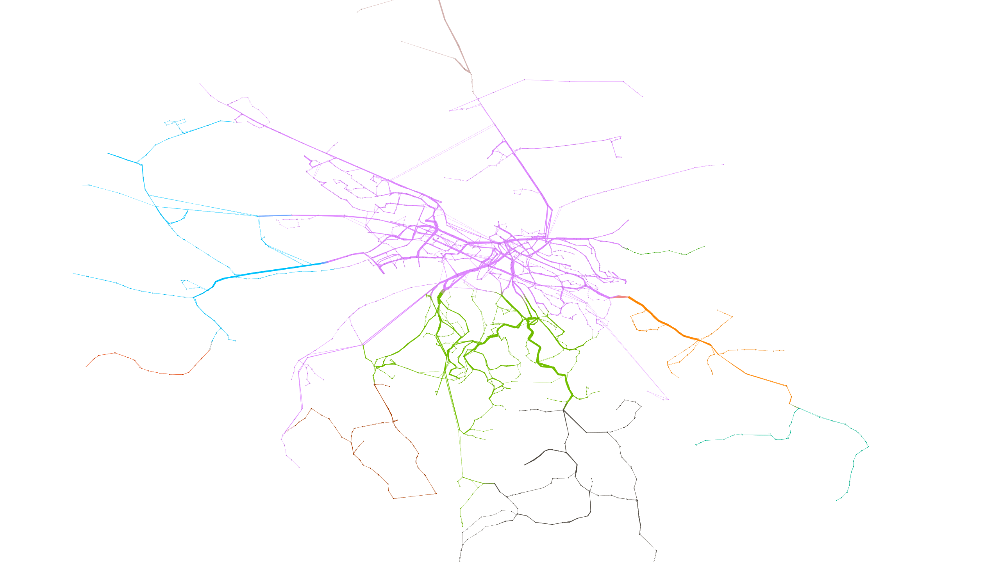

### BGNetP

In [ ]:
similarityMatrixP = calculateSimilarityMatrix(netP)
laplacianMatrixP = generateLaplacianMatrix(netP, similarityMatrixP)
evalsP = calculateEigenvalues(laplacianMatrixP)
plot_eigenvalues(evalsP[:15])

Za BGNetP mrežu dobar broj komuna je: 2, 6, 9, 11, 12, 13

In [ ]:
cluster(netP, similarityMatrixP, 9)

In [ ]:
output_path = master_path + "models/netP_clustered_9.gml"
nx.write_gml(netP, output_path)

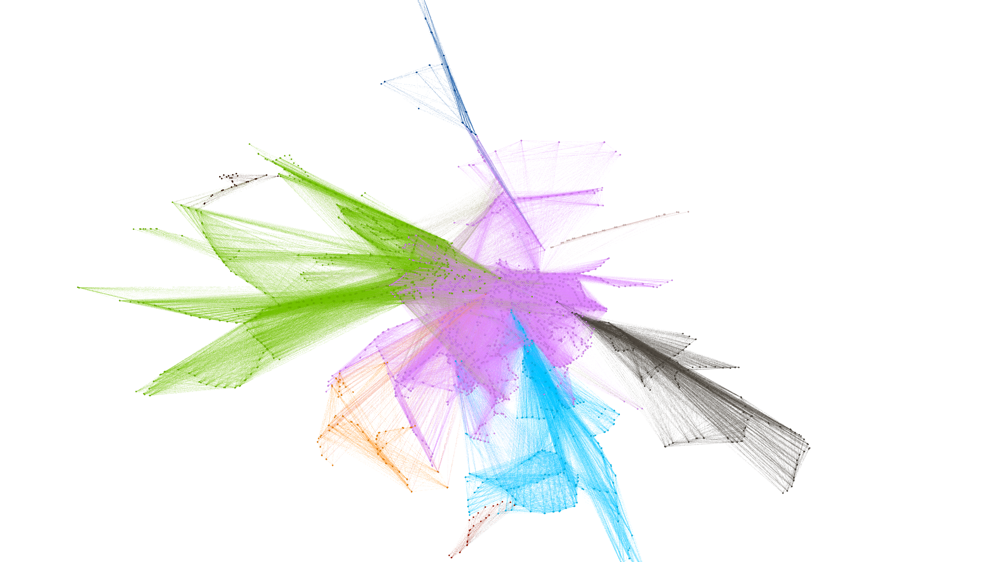